# Kernel-Predicting Convolutional Networks for Denoising Monte Carlo Renderings

Official website of the paper: http://drz.disneyresearch.com/~jnovak/publications/KPCN/

This is IPython notebook made by Nikola Bunjevac for experimenting with methods described in the paper.

## Instance setup

First we need to setup pyexr, torch and other libraries.

In [0]:
!pip install pyexr
!pip install torch
!pip install torchvision
!pip install scikit-image
!pip install scipy

  Running setup.py bdist_wheel for OpenEXR ... - \ | / - done
  Stored in directory: /root/.cache/pip/wheels/41/06/9f/c7dc838815b0e7dfc7d7dc19cc3d677edb47594d8489adc62a
Successfully built OpenEXR
    100% |████████████████████████████████| 591.8MB 30kB/s 
tcmalloc: large alloc 1073750016 bytes == 0x60ccc000 @  0x7f981bfa12a4 0x591a07 0x5b5d56 0x502e9a 0x506859 0x502209 0x502f3d 0x506859 0x504c28 0x502540 0x502f3d 0x506859 0x504c28 0x502540 0x502f3d 0x506859 0x504c28 0x502540 0x502f3d 0x507641 0x502209 0x502f3d 0x506859 0x504c28 0x502540 0x502f3d 0x507641 0x504c28 0x502540 0x502f3d 0x507641
    100% |████████████████████████████████| 61kB 2.8MB/s 
    100% |████████████████████████████████| 2.0MB 11.5MB/s 
  Found existing installation: Pillow 4.0.0
    Uninstalling Pillow-4.0.0:
      Successfully uninstalled Pillow-4.0.0
  [PIL]
You must restart the runtime in order to use newly installed versions.


In [0]:
# imports

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms

import pyexr

import matplotlib.pyplot as plt
import numpy as np
from scipy import ndimage

import random
from random import randint

import glob
import os
import time

# Dataset

Dataset consists of a large number of images rendered by modified [Tungsten renderer](https://benedikt-bitterli.me/tungsten.html). The reason it's modified is that additional features like normals, depth, visibility and so on are not usually part of the output, so they had to be added.

The dataset can be downloaded here: https://www.disneyresearch.com/publication/deep-learning-denoising/

Unfortunately, it doesn't fit on this instance, so we will be working with a small subset.

## About image data

Images are in EXR format and have multiple channels. To manipulate them Python wrapper for OpenEXR library, called PyEXR is used.
The repository is available here: https://github.com/tvogels/pyexr



In [0]:
# download sample image and name it sample.exr
!wget -O sample.exr https://www.dropbox.com/s/nhunb2e9i0dr8sz/10064185-00256spp.exr?dl=1 # note dl=1 instead of dl=0!
!wget -O sample2.exr https://www.dropbox.com/s/xjf395828x05lxr/10430937-00256spp.exr?dl=1
!wget -O sample3.exr https://www.dropbox.com/s/dzi8m1xpdutszeq/10095699-00256spp.exr?dl=1
!wget -O sample4.exr https://www.dropbox.com/s/wgkjmxaf3m2ldkf/10447261-00256spp.exr?dl=1
!wget -O sample5.exr https://www.dropbox.com/s/45tbqti8q5g55oa/10499343-00256spp.exr?dl=1
!wget -O sample6.exr https://www.dropbox.com/s/b0rwu7hcwkkmmm1/12421083-00256spp.exr?dl=1
!wget -O sample7.exr https://www.dropbox.com/s/7b06a2i4pvo95ec/10481186-00256spp.exr?dl=1
!wget -O sample8.exr https://www.dropbox.com/s/dgt3upcr9z089e4/10848082-00256spp.exr?dl=1
!wget -O sample9.exr https://www.dropbox.com/s/mooki46xmua6u21/11109097-00256spp.exr?dl=1
!wget -O sample10.exr https://www.dropbox.com/s/rlevs70jq3dh8kq/35930976-00256spp.exr?dl=1
  
!wget -O gt.exr https://www.dropbox.com/s/szhfit37cyhfk13/10064185-08192spp.exr?dl=1
!wget -O gt2.exr https://www.dropbox.com/s/o6n90rf9wal5v59/10430937-08192spp.exr?dl=1
!wget -O gt3.exr https://www.dropbox.com/s/amevblnfjk69k8p/10095699-08192spp.exr?dl=1
!wget -O gt4.exr https://www.dropbox.com/s/0cx5tjmmng28von/10447261-08192spp.exr?dl=1
!wget -O gt5.exr https://www.dropbox.com/s/bgq9v0967g8h7nl/10499343-08192spp.exr?dl=1
!wget -O gt6.exr https://www.dropbox.com/s/pr9z8t0g8vyotlj/12421083-08192spp.exr?dl=1
!wget -O gt7.exr https://www.dropbox.com/s/vtjx46jmo5nhrvf/10481186-08192spp.exr?dl=1
!wget -O gt8.exr https://www.dropbox.com/s/fkf63fq4azw0g9z/10848082-08192spp.exr?dl=1
!wget -O gt9.exr https://www.dropbox.com/s/5jq4q0m4sv3bw52/11109097-08192spp.exr?dl=1
!wget -O gt10.exr https://www.dropbox.com/s/d1qfcmdlx3hukls/35930976-08192spp.exr?dl=1
  
!wget -O eval1.exr https://www.dropbox.com/s/ion7q7osuyrplvg/41905363-00256spp.exr?dl=1
!wget -O eval2.exr https://www.dropbox.com/s/e9kyil0isfiu0ng/30265043-00256spp.exr?dl=1
!wget -O eval3.exr https://www.dropbox.com/s/pu4zkkk3119ytx1/11202348-00256spp.exr?dl=1
  
!wget -O evalref1.exr https://www.dropbox.com/s/so84617kw551e2m/41905363-08192spp.exr?dl=1
!wget -O evalref2.exr https://www.dropbox.com/s/uuudw2av8vgzsjw/30265043-08192spp.exr?dl=1
!wget -O evalref3.exr https://www.dropbox.com/s/gszm89oogjamiyi/11202348-08192spp.exr?dl=1

--2019-01-24 16:27:18--  https://www.dropbox.com/s/nhunb2e9i0dr8sz/10064185-00256spp.exr?dl=1
Resolving www.dropbox.com (www.dropbox.com)... 162.125.3.1, 2620:100:601b:1::a27d:801
Connecting to www.dropbox.com (www.dropbox.com)|162.125.3.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/dl/nhunb2e9i0dr8sz/10064185-00256spp.exr [following]
--2019-01-24 16:27:18--  https://www.dropbox.com/s/dl/nhunb2e9i0dr8sz/10064185-00256spp.exr
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc6eeeccc7450c7072502286979f.dl.dropboxusercontent.com/cd/0/get/AaBOgBebtftUGAOklZMqQfaxGHsFWUZmHMxYRqXIOXlC9IGaeIrZOQyA5wC3MvtxWqEnoye5o4MyUh9jUkRgthqGNxzPh0FCpbjcjG_DjBirHSAFFMLE6s1dk3WyYr_Dlxw/file?dl=1# [following]
--2019-01-24 16:27:18--  https://uc6eeeccc7450c7072502286979f.dl.dropboxusercontent.com/cd/0/get/AaBOgBebtftUGAOklZMqQfaxGHsFWUZmHMxYRqXIOXlC9IGaeIrZOQyA5wC3MvtxWqEnoye5o4MyUh9jUkRgt

Let's read the image and see what's inside.

In [0]:
file = pyexr.open("sample.exr")

print("Width:", file.width)
print("Height:", file.height)

print("Available channels:")
file.describe_channels()
  
print("Default channels:", file.channel_map['default'])


Width: 1280
Height: 720
Available channels:
R
G
B
albedo              R,G,B
albedoA             R,G,B
albedoVariance      Z
colorA              R,G,B
colorVariance       Z
depth               Z
depthA              Z
depthVariance       Z
diffuse             R,G,B
diffuseA            R,G,B
diffuseVariance     Z
normal              R,G,B
normalA             R,G,B
normalVariance      Z
specular            R,G,B
specularA           R,G,B
specularVariance    Z
visibility          Z
visibilityA         Z
visibilityVariance  Z
Default channels: ['R', 'G', 'B']


Channels ending with 'A' (e.g. normalA) are half buffers: mean of a half the samples, and can be used to estimate variance.

In [0]:
def show_data(data, figsize=(15, 15), normalize=False):
  if normalize:
    data = np.clip(data, 0, 1)**0.45454545
  plt.figure(figsize=figsize)
  imgplot = plt.imshow(data, aspect='equal')
  imgplot.axes.get_xaxis().set_visible(False)
  imgplot.axes.get_yaxis().set_visible(False)
  plt.show()
  

def show_data_sbs(data1, data2, figsize=(15, 15)):
  f, (ax1, ax2) = plt.subplots(1, 2, sharey=True, figsize=figsize)
  
  ax1.imshow(data1, aspect='equal')
  ax2.imshow(data2, aspect='equal')
  
  ax1.axis('off')
  ax2.axis('off')
  
  plt.show()
  

def show_channel(img, chan):
  data = img.get(chan)
  print("Channel:", chan)
  print("Shape:", data.shape)
  print(np.max(data), np.min(data))
  
  if chan in ["default", "diffuse", "albedo", "specular"]:
    data = np.clip(data, 0, 1)**0.45454545
  
  if chan in ["normal", "normalA"]:
    # normalize
    print("normalizing")
    for i in range(img.height):
      for j in range(img.width):
        data[i][j] = data[i][j] / np.linalg.norm(data[i][j])
    data = np.abs(data)
    
  if chan in ["depth", "visibility", "normalVariance"] and np.max(data) != 0:
    data /= np.max(data)
  
  if data.shape[2] == 1:
    print("Reshaping")
    data = data.reshape(img.height, img.width)

  show_data(data)
  
  

Channel: default
Shape: (720, 1280, 3)
14.4296875 0.0


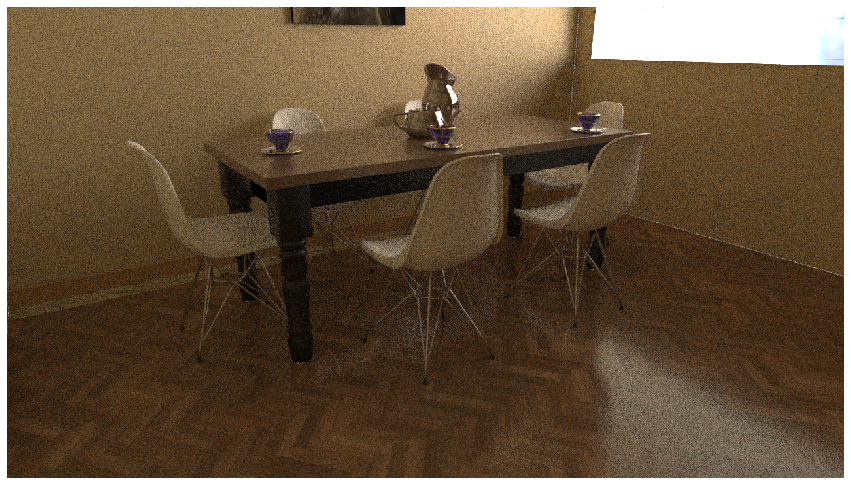

Channel: albedo
Shape: (720, 1280, 3)
1.0 0.0


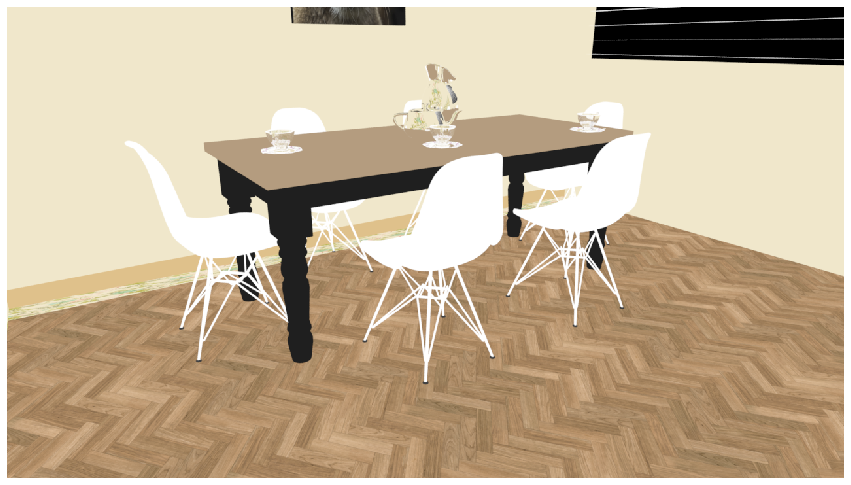

Channel: diffuse
Shape: (720, 1280, 3)
1.4199219 0.0


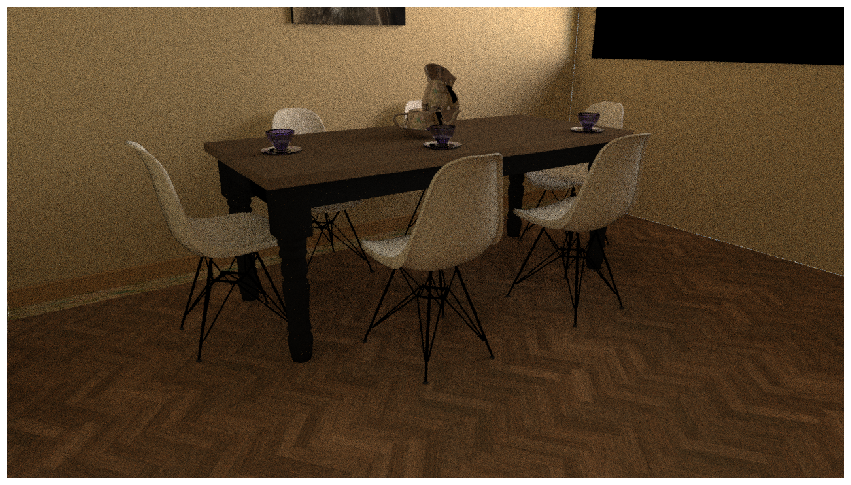

Channel: specular
Shape: (720, 1280, 3)
14.4296875 -0.0


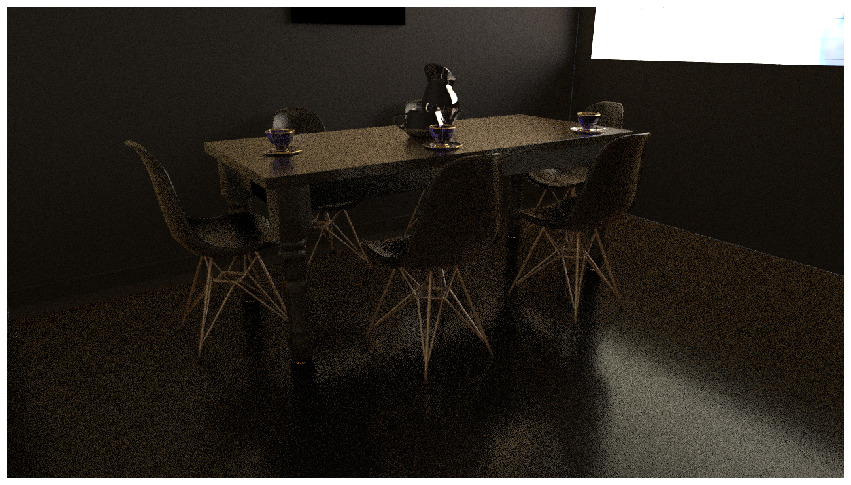

Channel: normal
Shape: (720, 1280, 3)
1.0 -1.0
normalizing


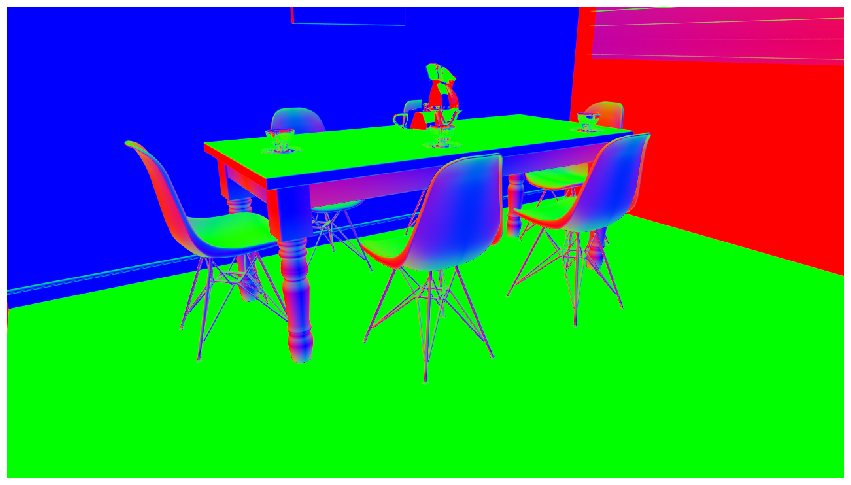

Channel: normalVariance
Shape: (720, 1280, 1)
0.0034370422 0.0
Reshaping


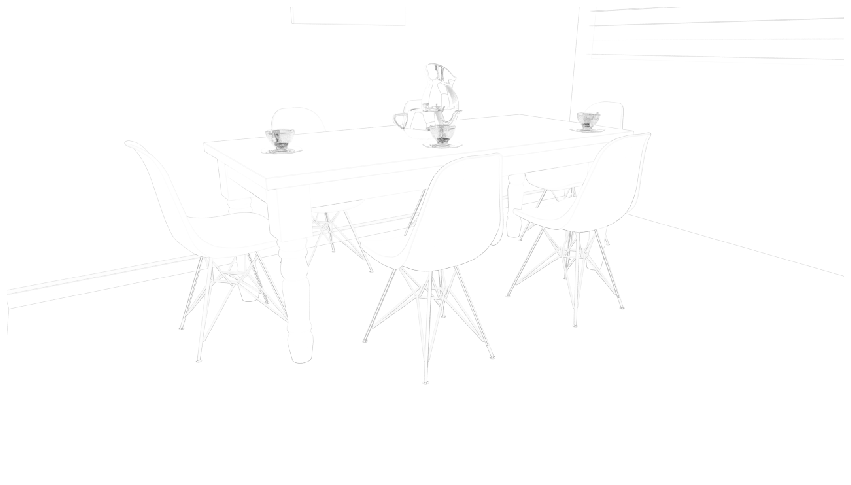

Channel: depth
Shape: (720, 1280, 1)
23.140625 0.0
Reshaping


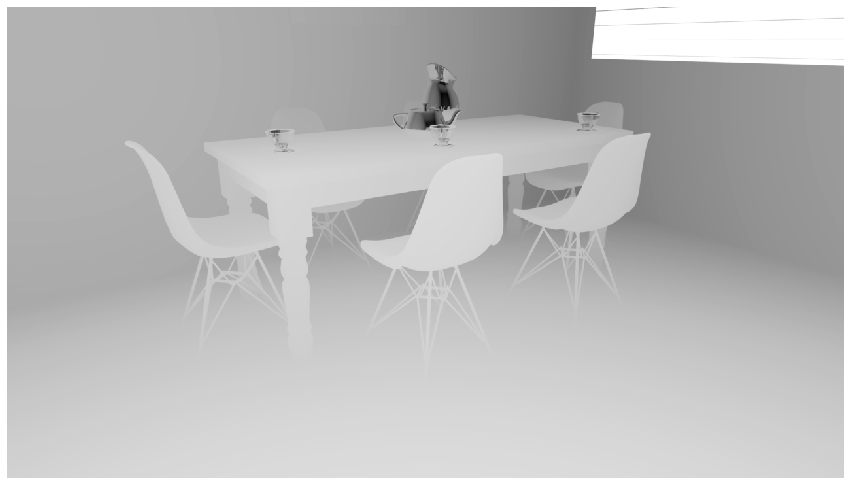

Channel: visibility
Shape: (720, 1280, 1)
0.10229492 0.0
Reshaping


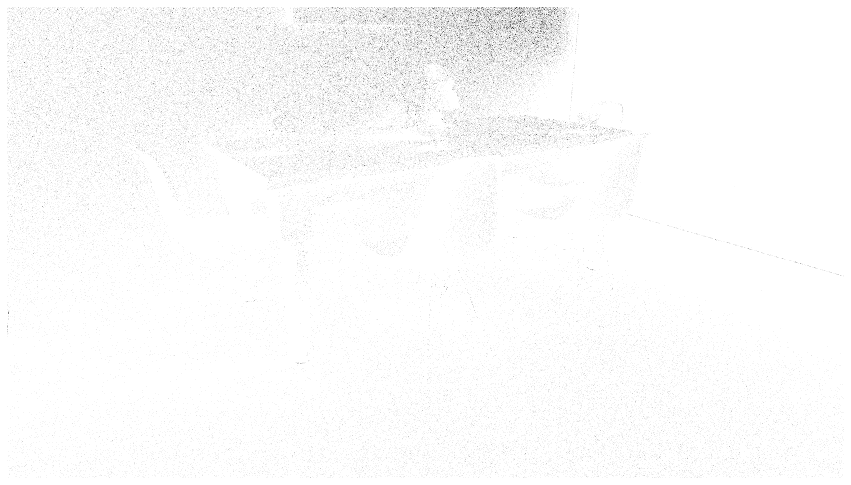

In [0]:
file = pyexr.open('sample.exr')

for chan in ["default", "albedo", "diffuse", "specular", "normal", "normalVariance", "depth", "visibility"]:
  show_channel(file, chan)

## Preprocessing

Images have to be preprocessed to achieve best results.

First of all, the network will be fed patches of size 64x64, not whole images. Furthermore, some transformations have to be applied to images and some features have to be calculated that will also be fed to the network.

### Diffuse

Diffuse component will be divided by albedo as given by
$$ \mathbf{\tilde{c}}_\text{diffuse} = \mathbf{c}_\text{diffuse} \oslash (\mathbf{f}_\text{albedo} + \epsilon), $$
where $\oslash$ is Hadamard's element-wise division, and $\epsilon = 0.00316$.

### Specular

Specular component will also be transformed since it can have large values. The transform is logarithmic as follows by
$$ \mathbf{\tilde{c}}_\text{specular} = \text{log}(\mathbf{c}_\text{specular} + 1). $$

### Variances

Since color channels were transformed, their variances will also have to be transformed.

$$ (\tilde{\sigma}_\text{diffuse})^2 \approx \sigma^2_\text{diffuse} \oslash (\mathbf{f}_\text{albedo} + \epsilon)^2$$

$$ (\tilde{\sigma}_\text{specular})^2 \approx \sigma^2_\text{specular} \oslash (\mathbf{\tilde{c}}_\text{specular})^2$$


### Gradients

Another auxiliary feature we have to calculate is gradient, in both $x$ and $y$ direction. The gradient is defined as difference of neighbouring pixels and denoted by $G_x$ and $G_y$.

**Note**: Network output will have to postprocessed by inverse of the described operations.

## Network inputs

After these transformations, the network input will be

$$ \mathbf{x} = \{\mathbf{\tilde{c}}, G_x(\{\mathbf{\tilde{c}, f}\}), G_y(\{\mathbf{\tilde{c}, f}\}), \tilde{\sigma}^2, \sigma_\mathbf{f}^2 \}$$

where $\mathbf{\tilde{c}}$ and $ \tilde{\sigma}^2$ are either diffuse or specular, depending on the subnetwork.

In [0]:
# some constants

patch_size = 64 # patches are 64x64
n_patches = 400
eps = 0.00316


In [0]:
def build_data(img):
  data = img.get()


def preprocess_diffuse(diffuse, albedo):
  return diffuse / (albedo + eps)


def postprocess_diffuse(diffuse, albedo):
  return diffuse * (albedo + eps)


def preprocess_specular(specular):
  assert(np.sum(specular < 0) == 0)
  return np.log(specular + 1)


def postprocess_specular(specular):
  return np.exp(specular) - 1


def preprocess_diff_var(variance, albedo):
  return variance / (albedo + eps)**2


def preprocess_spec_var(variance, specular):
  return variance / (specular+1e-5)**2


def gradients(data):
  h, w, c = data.shape
  dX = data[:, 1:, :] - data[:, :w - 1, :]
  dY = data[1:, :, :] - data[:h - 1, :, :]
  # padding with zeros
  dX = np.concatenate((np.zeros([h,1,c], dtype=np.float32),dX), axis=1)
  dY = np.concatenate((np.zeros([1,w,c], dtype=np.float32),dY), axis=0)
  
  return np.concatenate((dX, dY), axis=2)


Final color is combination of diffuse and specular components.

Therefore, we can combine diffuse and specular component together by adding them to get final color and analogically, we can decompose final color to diffuse and specular components.

In [0]:
def remove_channels(data, channels):
  for c in channels:
    if c in data:
      del data[c]
    else:
      print("Channel {} not found in data!".format(c))

      
# returns network input data from noisy .exr file
def preprocess_input(filename, gt, debug=False):
  
  file = pyexr.open(filename)
  data = file.get_all()
  
  if debug:
    for k, v in data.items():
      print(k, v.dtype)

  # just in case
  for k, v in data.items():
    data[k] = np.nan_to_num(v)

    
    
  file_gt = pyexr.open(gt)
  gt_data = file_gt.get_all()
  
  # just in case
  for k, v in gt_data.items():
    gt_data[k] = np.nan_to_num(v)
    
    
  # clip specular data so we don't have negative values in logarithm
  data['specular'] = np.clip(data['specular'], 0, np.max(data['specular']))
  data['specularVariance'] = np.clip(data['specularVariance'], 0, np.max(data['specularVariance']))
  gt_data['specular'] = np.clip(data['specular'], 0, np.max(data['specular']))
  gt_data['specularVariance'] = np.clip(gt_data['specularVariance'], 0, np.max(gt_data['specularVariance']))
    
    
  # save albedo
  data['origAlbedo'] = data['albedo'].copy()
    
  # save reference data (diffuse and specular)
  diff_ref = preprocess_diffuse(gt_data['diffuse'], gt_data['albedo'])
  spec_ref = preprocess_specular(gt_data['specular'])
  diff_sample = preprocess_diffuse(data['diffuse'], data['albedo'])
  
  data['Reference'] = np.concatenate((diff_ref[:,:,:3].copy(), spec_ref[:,:,:3].copy()), axis=2)
  data['Sample'] = np.concatenate((diff_sample, data['specular']), axis=2)
  
  # save final input and reference for error calculation
  # apply albedo and add specular component to get final color
  data['finalGt'] = gt_data['default']#postprocess_diffuse(data['Reference'][:,:,:3], data['albedo']) + data['Reference'][:,:,3:]
  data['finalInput'] = data['default']#postprocess_diffuse(data['diffuse'][:,:,:3], data['albedo']) + data['specular'][:,:,3:]
    
    
    
    
  # preprocess diffuse
  data['diffuse'] = preprocess_diffuse(data['diffuse'], data['albedo'])

  # preprocess diffuse variance
  data['diffuseVariance'] = preprocess_diff_var(data['diffuseVariance'], data['albedo'])

  # preprocess specular
  data['specular'] = preprocess_specular(data['specular'])

  # preprocess specular variance
  data['specularVariance'] = preprocess_spec_var(data['specularVariance'], data['specular'])

  # just in case
  data['depth'] = np.clip(data['depth'], 0, np.max(data['depth']))

  # normalize depth
  max_depth = np.max(data['depth'])
  if (max_depth != 0):
    data['depth'] /= max_depth
    # also have to transform the variance
    data['depthVariance'] /= max_depth * max_depth

  # Calculate gradients of features (not including variances)
  data['gradNormal'] = gradients(data['normal'][:, :, :3].copy())
  data['gradDepth'] = gradients(data['depth'][:, :, :1].copy())
  data['gradAlbedo'] = gradients(data['albedo'][:, :, :3].copy())
  data['gradSpecular'] = gradients(data['specular'][:, :, :3].copy())
  data['gradDiffuse'] = gradients(data['diffuse'][:, :, :3].copy())
  data['gradIrrad'] = gradients(data['default'][:, :, :3].copy())

  # append variances and gradients to data tensors
  data['diffuse'] = np.concatenate((data['diffuse'], data['diffuseVariance'], data['gradDiffuse']), axis=2)
  data['specular'] = np.concatenate((data['specular'], data['specularVariance'], data['gradSpecular']), axis=2)
  data['normal'] = np.concatenate((data['normalVariance'], data['gradNormal']), axis=2)
  data['depth'] = np.concatenate((data['depthVariance'], data['gradDepth']), axis=2)

  if debug:
    for k, v in data.items():
      print(k, v.shape, v.dtype)

  X_diff = np.concatenate((data['diffuse'],
                           data['normal'],
                           data['depth'],
                           data['gradAlbedo']), axis=2)

  X_spec = np.concatenate((data['specular'],
                           data['normal'],
                           data['depth'],
                           data['gradAlbedo']), axis=2)
  
  assert not np.isnan(X_diff).any()
  assert not np.isnan(X_spec).any()

  print("X_diff shape:", X_diff.shape)
  print(X_diff.dtype, X_spec.dtype)
  
  data['X_diff'] = X_diff
  data['X_spec'] = X_spec
  
  remove_channels(data, ('diffuseA', 'specularA', 'normalA', 'albedoA', 'depthA',
                         'visibilityA', 'colorA', 'gradNormal', 'gradDepth', 'gradAlbedo',
                        'gradSpecular', 'gradDiffuse', 'gradIrrad', 'albedo', 'diffuse', 
                         'depth', 'specular', 'diffuseVariance', 'specularVariance',
                        'depthVariance', 'visibilityVariance', 'colorVariance',
                        'normalVariance', 'depth', 'visibility'))
  
  return data

normalA float32
diffuse float32
default float32
colorVariance float32
albedoA float32
visibilityVariance float32
diffuseA float32
normalVariance float32
depthA float32
specularVariance float32
albedoVariance float32
depth float32
diffuseVariance float32
specularA float32
albedo float32
colorA float32
normal float32
depthVariance float32
visibilityA float32
visibility float32
specular float32
normalA (720, 1280, 3) float32
diffuse (720, 1280, 12) float32
default (720, 1280, 3) float32
colorVariance (720, 1280, 1) float32
albedoA (720, 1280, 3) float32
visibilityVariance (720, 1280, 1) float32
diffuseA (720, 1280, 3) float32
normalVariance (720, 1280, 1) float32
depthA (720, 1280, 1) float32
specularVariance (720, 1280, 3) float32
albedoVariance (720, 1280, 1) float32
depth (720, 1280, 3) float32
diffuseVariance (720, 1280, 3) float32
specularA (720, 1280, 3) float32
albedo (720, 1280, 3) float32
colorA (720, 1280, 3) float32
normal (720, 1280, 7) float32
depthVariance (720, 1280, 1) flo

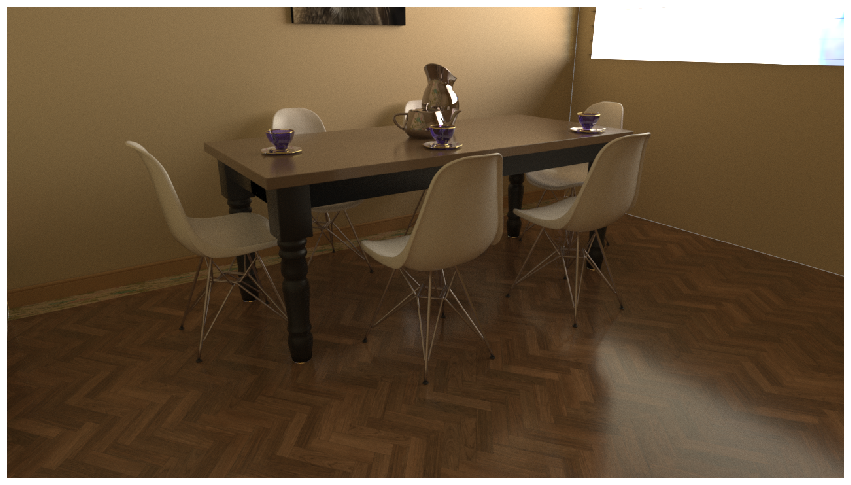

In [0]:
data = preprocess_input("sample.exr", "gt.exr", debug=True)

for k, v in data.items():
  print(k, "has nans:", np.isnan(v).any())
  
print("Let's check finalGt: ")
show_data(np.clip(data['finalGt'], 0, 1)**0.45454545)

## Patches

Next, we have to generate patches.

**Note**: Most of this code was borrowed from official paper implementation which can be found [here](http://drz.disneyresearch.com/~jnovak/publications/KPCN/).

In [0]:
def getVarianceMap(data, patch_size, relative=False):

  # introduce a dummy third dimension if needed
  if data.ndim < 3:
      data = data[:,:,np.newaxis]

  # compute variance
  mean = ndimage.uniform_filter(data, size=(patch_size, patch_size, 1))
  sqrmean = ndimage.uniform_filter(data**2, size=(patch_size, patch_size, 1))
  variance = np.maximum(sqrmean - mean**2, 0)

  # convert to relative variance if requested
  if relative:
      variance = variance/np.maximum(mean**2, 1e-2)

  # take the max variance along the three channels, gamma correct it to get a
  # less peaky map, and normalize it to the range [0,1]
  variance = variance.max(axis=2)
  variance = np.minimum(variance**(1.0/2.2), 1.0)

  return variance/variance.max()


# Generate importance sampling map based on buffer and desired metric
def getImportanceMap(buffers, metrics, weights, patch_size):
  if len(metrics) != len(buffers):
      metrics = [metrics[0]]*len(buffers)
  if len(weights) != len(buffers):
      weights = [weights[0]]*len(buffers)
  impMap = None
  for buf, metric, weight in zip(buffers, metrics, weights):
      if metric == 'uniform':
          cur = np.ones(buf.shape[:2], dtype=np.float)
      elif metric == 'variance':
          cur = getVarianceMap(buf, patch_size, relative=False)
      elif metric == 'relvar':
          cur = getVarianceMap(buf, patch_size, relative=True)
      else:
          print('Unexpected metric:', metric)
      if impMap is None:
          impMap = cur*weight
      else:
          impMap += cur*weight
  return impMap / impMap.max()


def samplePatchesProg(img_dim, patch_size, n_samples, maxiter=5000):

  # Sample patches using dart throwing (works well for sparse/non-overlapping patches)

  # estimate each sample patch area
  full_area = float(img_dim[0]*img_dim[1])
  sample_area = full_area/n_samples

  # get corresponding dart throwing radius
  radius = np.sqrt(sample_area/np.pi)
  minsqrdist = (2*radius)**2

  # compute the distance to the closest patch
  def get_sqrdist(x, y, patches):
      if len(patches) == 0:
          return np.infty
      dist = patches - [x, y]
      return np.sum(dist**2, axis=1).min()

  # perform dart throwing, progressively reducing the radius
  rate = 0.96
  patches = np.zeros((n_samples,2), dtype=int)
  xmin, xmax = 0, img_dim[1] - patch_size[1] - 1
  ymin, ymax = 0, img_dim[0] - patch_size[0] - 1
  for patch in range(n_samples):
      done = False
      while not done:
          for i in range(maxiter):
              x = randint(xmin, xmax)
              y = randint(ymin, ymax)
              sqrdist = get_sqrdist(x, y, patches[:patch,:])
              if sqrdist > minsqrdist:
                  patches[patch,:] = [x, y]
                  done = True
                  break
          if not done:
              radius *= rate
              minsqrdist = (2*radius)**2

  return patches

  
def prunePatches(shape, patches, patchsize, imp):

  pruned = np.empty_like(patches)

  # Generate a set of regions tiling the image using snake ordering.
  def get_regions_list(shape, step):
      regions = []
      for y in range(0, shape[0], step):
          if y//step % 2 == 0:
              xrange = range(0, shape[1], step)
          else:
              xrange = reversed(range(0, shape[1], step))
          for x in xrange:
              regions.append((x, x + step, y, y + step))
      return regions

  # Split 'patches' in current and remaining sets, where 'cur' holds the
  # patches in the requested region, and 'rem' holds the remaining patches.
  def split_patches(patches, region):
      cur = np.empty_like(patches)
      rem = np.empty_like(patches)
      ccount, rcount = 0, 0
      for i in range(patches.shape[0]):
          x, y = patches[i,0], patches[i,1]
          if region[0] <= x < region[1] and region[2] <= y < region[3]:
              cur[ccount,:] = [x,y]
              ccount += 1
          else:
              rem[rcount,:] = [x,y]
              rcount += 1
      return cur[:ccount,:], rem[:rcount,:]

  # Process all patches, region by region, pruning them randomly according to
  # their importance value, ie. patches with low importance have a higher
  # chance of getting pruned. To offset the impact of the binary pruning
  # decision, we propagate the discretization error and take it into account
  # when pruning.
  rem = np.copy(patches)
  count, error = 0, 0
  for region in get_regions_list(shape, 4*patchsize):
      cur, rem = split_patches(rem, region)
      for i in range(cur.shape[0]):
          x, y = cur[i,0], cur[i,1]
          if imp[y,x] - error > random.random():
              pruned[count,:] = [x, y]
              count += 1
              error += 1 - imp[y,x]
          else:
              error += 0 - imp[y,x]

  return pruned[:count,:]
  
  
def importanceSampling(data, debug=False):
  global patch_size, n_patches
  
  # extract buffers
  buffers = []
  for b in ['default', 'normal']:
      buffers.append(data[b][:,:,:3])

  # build the metric map
  metrics = ['relvar', 'variance']
  weights = [1.0, 1.0]
  imp = getImportanceMap(buffers, metrics, weights, patch_size)
  
  if debug:
    print("Importance map:")
    plt.figure(figsize = (15,15))
    imgplot = plt.imshow(imp)
    imgplot.axes.get_xaxis().set_visible(False)
    imgplot.axes.get_yaxis().set_visible(False)
    plt.show()

  # get patches
  patches = samplePatchesProg(buffers[0].shape[:2], (patch_size, patch_size), n_patches)
  
  if debug:
    print("Patches:")
    plt.figure(figsize=(15, 10))
    plt.scatter(list(a[0] for a in patches), list(a[1] for a in patches))
    plt.show()
  
  selection = buffers[0] * 0.1
  for i in range(patches.shape[0]):
      x, y = patches[i,0], patches[i,1]
      selection[y:y+patch_size,x:x+patch_size,:] = buffers[0][y:y+patch_size,x:x+patch_size,:]

  
      
  # prune patches
  pad = patch_size // 2
  pruned = np.maximum(0, prunePatches(buffers[0].shape[:2], patches + pad, patch_size, imp) - pad)
  selection = buffers[0]*0.1
  for i in range(pruned.shape[0]):
      x, y = pruned[i,0], pruned[i,1]
      selection[y:y+patch_size,x:x+patch_size,:] = buffers[0][y:y+patch_size,x:x+patch_size,:]

  if debug:
    print("After pruning:")
    plt.figure(figsize=(15, 10))
    plt.scatter(list(a[0] for a in pruned), list(a[1] for a in pruned))
    plt.show()
      
  return (pruned + pad)

Importance map:


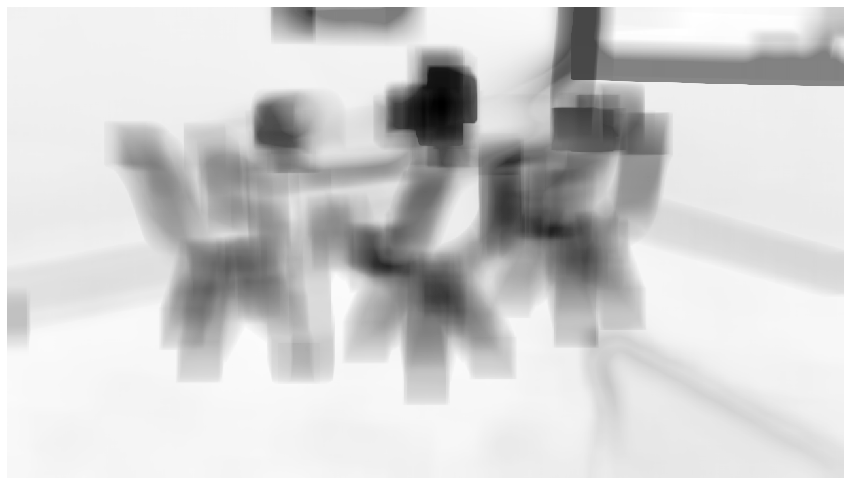

Patches:


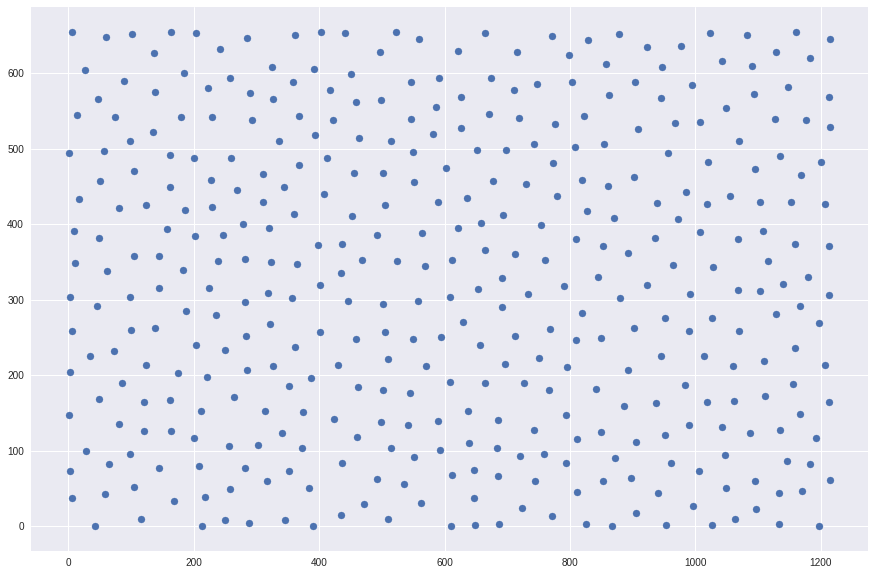

After pruning:


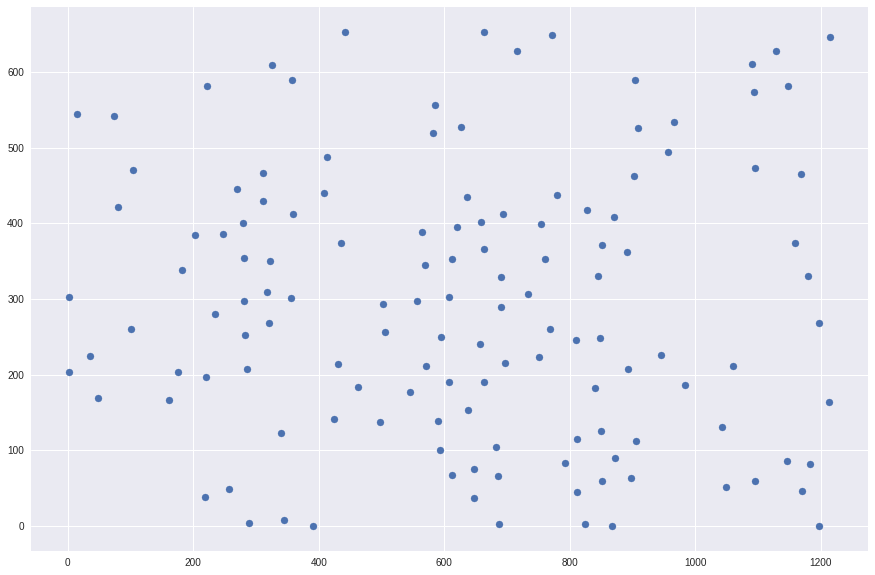

In [0]:
# coordinates of chosen patches
patches = importanceSampling(data, debug=True)

133
Sampling of chosen patches:


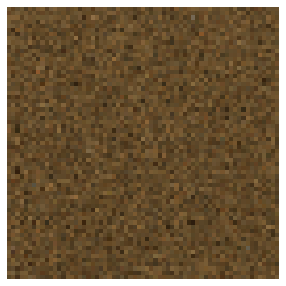

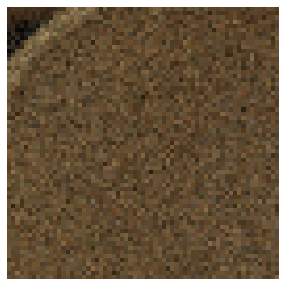

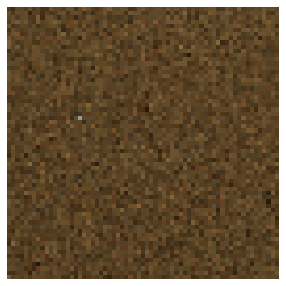

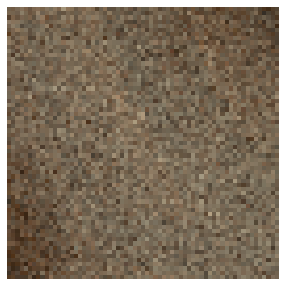

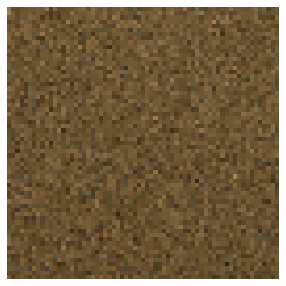

In [0]:
# crops all channels
def crop(data, pos, patch_size):
  half_patch = patch_size // 2
  sx, sy = half_patch, half_patch
  px, py = pos
  return {key: val[(py-sy):(py+sy+1),(px-sx):(px+sx+1),:] 
          for key, val in data.items()}


cropped = list(crop(data, tuple(pos), patch_size) for pos in patches)


print(len(cropped))

print("Sampling of chosen patches:")
for i in range(5):
  data_ = np.clip(cropped[np.random.randint(0, len(cropped))]['default'], 0, 1)**0.45454545
  plt.figure(figsize = (5,5))
  imgplot = plt.imshow(data_)
  imgplot.axes.get_xaxis().set_visible(False)
  imgplot.axes.get_yaxis().set_visible(False)
  plt.show()

In [0]:
def get_cropped_patches(sample_file, gt_file):
  data = preprocess_input(sample_file, gt_file)
  patches = importanceSampling(data)
  cropped = list(crop(data, tuple(pos), patch_size) for pos in patches)
  
  return cropped
  
  
for f in glob.glob('sample*.exr'):
  if f == 'sample.exr': continue
  num = f[len('sample'):f.index('.')]
  sample_name = 'sample{}.exr'.format(num)
  gt_name = 'gt{}.exr'.format(num)
  print(sample_name, gt_name)
  cropped += get_cropped_patches(sample_name, gt_name)

sample2.exr gt2.exr
X_diff shape: (720, 1280, 28)
float32 float32
Channel depth not found in data!
sample4.exr gt4.exr
X_diff shape: (720, 1280, 28)
float32 float32
Channel depth not found in data!
sample7.exr gt7.exr
X_diff shape: (720, 1280, 28)
float32 float32
Channel depth not found in data!
sample9.exr gt9.exr
X_diff shape: (720, 1280, 28)
float32 float32
Channel depth not found in data!
sample6.exr gt6.exr
X_diff shape: (720, 1280, 28)
float32 float32
Channel depth not found in data!
sample3.exr gt3.exr
X_diff shape: (720, 1280, 28)
float32 float32
Channel depth not found in data!
sample5.exr gt5.exr
X_diff shape: (720, 1280, 28)
float32 float32
Channel depth not found in data!
sample10.exr gt10.exr
X_diff shape: (720, 1280, 28)
float32 float32
Channel depth not found in data!
sample8.exr gt8.exr
X_diff shape: (720, 1280, 28)
float32 float32
Channel depth not found in data!


In [0]:
def to_torch_tensors(data):
  if isinstance(data, dict):
    for k, v in data.items():
      if not isinstance(v, torch.Tensor):
        data[k] = torch.from_numpy(v)
  elif isinstance(data, list):
    for i, v in enumerate(data):
      if not isinstance(v, torch.Tensor):
        data[i] = to_torch_tensors(v)
    
  return data
 
def send_to_device(data):
  if isinstance(data, dict):
    for k, v in data.items():
      if isinstance(v, torch.Tensor):
        data[k] = v.to(device)
  elif isinstance(data, list):
    for i, v in enumerate(data):
      if isinstance(v, torch.Tensor):
        data[i] = v.to(device)
    
  return data
  
  
print(len(cropped))
print(type(cropped[0]))

1478
<class 'dict'>


In [0]:

# save the training data
#torch.save(data, 'train.pt')
#torch.save(cropped, 'patches.pt')

for i, v in enumerate(cropped):
  torch.save(v, 'sample'+str(i+1)+'.pt')

In [0]:
# https://stackoverflow.com/questions/13530762/how-to-know-bytes-size-of-python-object-like-arrays-and-dictionaries-the-simp/53705610#53705610

import gc
import sys

def getsize(obj):
    marked = {id(obj)}
    obj_q = [obj]
    sz = 0

    while obj_q:
        sz += sum(map(sys.getsizeof, obj_q))

        # Lookup all the object reffered to by the object in obj_q.
        # See: https://docs.python.org/3.7/library/gc.html#gc.get_referents
        all_refr = ((id(o), o) for o in gc.get_referents(*obj_q))

        # Filter object that are already marked.
        # Using dict notation will prevent repeated objects.
        new_refr = {o_id: o for o_id, o in all_refr if o_id not in marked and not isinstance(o, type)}

        # The new obj_q will be the ones that were not marked,
        # and we will update marked with their ids so we will
        # not traverse them again.
        obj_q = new_refr.values()
        marked.update(new_refr.keys())

    return sz
  

for k, v in cropped[0].items():
  print(k, getsize(v))
  
print(getsize(cropped) / 1024 / 1024, "MiB")

normal 128
default 128
albedoVariance 128
origAlbedo 128
Reference 128
Sample 128
finalGt 128
finalInput 128
X_diff 128
X_spec 128
2.3230514526367188 MiB


Make a dataset class.

In [0]:
class KPCNDataset(torch.utils.data.Dataset):
  def __init__(self):
    self.samples = cropped

  def __len__(self):
    return len(self.samples)

  def __getitem__(self, idx):
    return self.samples[idx]

In [0]:
cropped = to_torch_tensors(cropped)
cropped = send_to_device(cropped)

Let's give it a try.

Left: noisy,    Right: reference


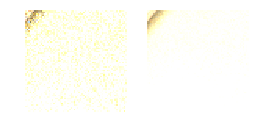

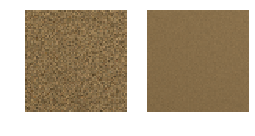

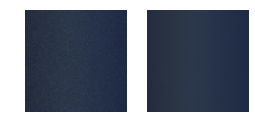

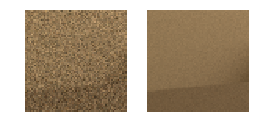

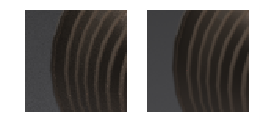

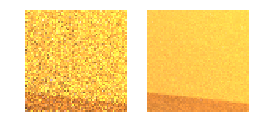

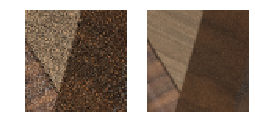

In [0]:
dataset = KPCNDataset()

print("Left: noisy,    Right: reference")

for i in range(len(dataset)):
  sample = dataset[np.random.randint(0, len(dataset))]
  
  data_sample = np.clip(sample['default'], 0, 1)**0.45454545
  data_ref = np.clip(sample['finalGt'], 0, 1)**0.45454545
  show_data_sbs(data_sample, data_ref, figsize=(4, 2))
  
  
  if i == 6:
    break

# Model

The model consists of two convolutional neural subnetworks which are connected into larger network:
1. Diffuse CNN
2. Specular CNN

The reason for two subnetworks is that diffuse and specular components have different properties and it is better to treat them separately. In the end, two outputs of neural subnetworks are added back together to form final color (RGB) image.

Also, there are two variants of subnetworks.

## DPCN

Direct prediction conv. network directly denoises the image, i.e. the output is denoised image.

## KPCN

Kernel prediction conv. network is an "upgrade". It spits out kernel which then denoises the image when applied to it.


Authors found that both versions converge to approximately the same result, but KPCN had a lot better convergence rate, i.e. it was quicker to train for the same result. They report about 5-6x speedup.

## Setup

In [0]:
# set device to GPU if available
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

print(device)

cuda:0


## Neural network(s)

Neural network consists solely of convolutional and ReLU layers. There are $L$ convolutional layers, every except the last one followed by ReLU function.

In [0]:
mode = 'KPCN' # 'KPCN' or 'DPCN'

recon_kernel_size = 21

# some network parameters
L = 9 # number of convolutional layers
n_kernels = 100 # number of kernels in each layer
kernel_size = 5 # size of kernel (square)

input_channels = dataset[0]['X_diff'].shape[-1]
hidden_channels = 100

print("Input channels:", input_channels)

# BHWC -> BCHW
permutation = [0, 3, 1, 2]


Input channels: 28


In [0]:
# torch.nn.Conv2d(in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1, groups=1, bias=True)
def make_net(n_layers, mode):
  # create first layer manually
  layers = [
      nn.Conv2d(input_channels, hidden_channels, kernel_size),
      nn.ReLU()
  ]
  
  for l in range(n_layers-2):
    layers += [
        nn.Conv2d(hidden_channels, hidden_channels, kernel_size),
        nn.ReLU()
    ]
    
    params = sum(p.numel() for p in layers[-2].parameters() if p.requires_grad)
    print(params)
    
  out_channels = 3 if mode == 'DPCN' else recon_kernel_size**2
  layers += [nn.Conv2d(hidden_channels, out_channels, kernel_size)]#, padding=18)]
  
  for layer in layers:
    if isinstance(layer, nn.Conv2d):
      nn.init.xavier_uniform_(layer.weight)
  
  return nn.Sequential(*layers)

In [0]:
def crop_like(data, like, debug=False):
  if data.shape[-2:] != like.shape[-2:]:
    # crop
    with torch.no_grad():
      dx, dy = data.shape[-2] - like.shape[-2], data.shape[-1] - like.shape[-1]
      data = data[:,:,dx//2:-dx//2,dy//2:-dy//2]
      if debug:
        print(dx, dy)
        print("After crop:", data.shape)
  return data

In [0]:
def apply_kernel(weights, data):
    # apply softmax to kernel weights
    weights = weights.permute((0, 2, 3, 1)).to(device)
    _, _, h, w = data.size()
    weights = F.softmax(weights, dim=3).view(-1, w * h, recon_kernel_size, recon_kernel_size)

    # now we have to apply kernels to every pixel
    # first pad the input
    r = recon_kernel_size // 2
    data = F.pad(data[:,:3,:,:], (r,) * 4, "reflect")
    
    #print(data[0,:,:,:])
    
    # make slices
    R = []
    G = []
    B = []
    kernels = []
    for i in range(h):
      for j in range(w):
        pos = i*h+j
        ws = weights[:,pos:pos+1,:,:]
        kernels += [ws, ws, ws]
        sy, ey = i+r-r, i+r+r+1
        sx, ex = j+r-r, j+r+r+1
        R.append(data[:,0:1,sy:ey,sx:ex])
        G.append(data[:,1:2,sy:ey,sx:ex])
        B.append(data[:,2:3,sy:ey,sx:ex])
        #slices.append(data[:,:,sy:ey,sx:ex])
        
    reds = (torch.cat(R, dim=1).to(device)*weights).sum(2).sum(2)
    greens = (torch.cat(G, dim=1).to(device)*weights).sum(2).sum(2)
    blues = (torch.cat(B, dim=1).to(device)*weights).sum(2).sum(2)
    
    #pixels = torch.cat(slices, dim=1).to(device)
    #kerns = torch.cat(kernels, dim=1).to(device)
    
    #print("Kerns:", kerns.size())
    #print(kerns[0,:5,:,:])
    #print("Pixels:", pixels.size())
    #print(pixels[0,:5,:,:])
    
    #res = (pixels * kerns).sum(2).sum(2).view(-1, 3, h, w).to(device)
    
    #tmp = (pixels * kerns).sum(2).sum(2)
    
    #print(tmp.size(), tmp[0,:10])
    
    #print("Res:", res.size(), res[0,:5,:,:])
    #print("Data:", data[0,:5,:,:])
    
    res = torch.cat((reds, greens, blues), dim=1).view(-1, 3, h, w).to(device)
    
    return res

In [0]:
import torch.optim as optim


def train(mode='KPCN', epochs=20, learning_rate=1e-4, show_images=False):
  dataset = KPCNDataset()
  dataloader = torch.utils.data.DataLoader(dataset, batch_size=4,
                          shuffle=True, num_workers=4)

  # instantiate networks
  diffuseNet = make_net(L, mode).to(device)
  specularNet = make_net(L, mode).to(device)

  print(diffuseNet, "CUDA:", next(diffuseNet.parameters()).is_cuda)
  print(specularNet, "CUDA:", next(specularNet.parameters()).is_cuda)
  
  criterion = nn.L1Loss()

  optimizerDiff = optim.Adam(diffuseNet.parameters(), lr=learning_rate)
  optimizerSpec = optim.Adam(specularNet.parameters(), lr=learning_rate)

  accuLossDiff = 0
  accuLossSpec = 0
  accuLossFinal = 0
  
  lDiff = []
  lSpec = []
  lFinal = []

  import time

  start = time.time()

  for epoch in range(epochs):
    for i_batch, sample_batched in enumerate(dataloader):
      #print(i_batch)

      # get the inputs
      X_diff = sample_batched['X_diff'].permute(permutation).to(device)
      Y_diff = sample_batched['Reference'][:,:,:,:3].permute(permutation).to(device)

      # zero the parameter gradients
      optimizerDiff.zero_grad()

      # forward + backward + optimize
      outputDiff = diffuseNet(X_diff)

      # print(outputDiff.shape)

      if mode == 'KPCN':
        X_input = crop_like(X_diff, outputDiff)
        outputDiff = apply_kernel(outputDiff, X_input)

      Y_diff = crop_like(Y_diff, outputDiff)

      lossDiff = criterion(outputDiff, Y_diff)
      lossDiff.backward()
      optimizerDiff.step()

      # get the inputs
      X_spec = sample_batched['X_spec'].permute(permutation).to(device)
      Y_spec = sample_batched['Reference'][:,:,:,3:6].permute(permutation).to(device)

      # zero the parameter gradients
      optimizerSpec.zero_grad()

      # forward + backward + optimize
      outputSpec = specularNet(X_spec)

      if mode == 'KPCN':
        X_input = crop_like(X_spec, outputSpec)
        outputSpec = apply_kernel(outputSpec, X_input)

      Y_spec = crop_like(Y_spec, outputSpec)

      lossSpec = criterion(outputSpec, Y_spec)
      lossSpec.backward()
      optimizerSpec.step()

      # calculate final ground truth error
      with torch.no_grad():
        albedo = sample_batched['origAlbedo'].permute(permutation).to(device)
        albedo = crop_like(albedo, outputDiff)
        outputFinal = outputDiff * (albedo + eps) + torch.exp(outputSpec) - 1.0

        if False:#i_batch % 500:
          print("Sample, denoised, gt")
          sz = 3
          orig = crop_like(sample_batched['finalInput'].permute(permutation), outputFinal)
          orig = orig.cpu().permute([0, 2, 3, 1]).numpy()[0,:]
          show_data(orig, figsize=(sz,sz), normalize=True)
          img = outputFinal.cpu().permute([0, 2, 3, 1]).numpy()[0,:]
          show_data(img, figsize=(sz,sz), normalize=True)
          gt = crop_like(sample_batched['finalGt'].permute(permutation), outputFinal)
          gt = gt.cpu().permute([0, 2, 3, 1]).numpy()[0,:]
          show_data(gt, figsize=(sz,sz), normalize=True)

        Y_final = sample_batched['finalGt'].permute(permutation).to(device)

        Y_final = crop_like(Y_final, outputFinal)

        lossFinal = criterion(outputFinal, Y_final)

        accuLossFinal += lossFinal.item()

      accuLossDiff += lossDiff.item()
      accuLossSpec += lossSpec.item()

    print("Epoch {}".format(epoch + 1))
    print("LossDiff: {}".format(accuLossDiff))
    print("LossSpec: {}".format(accuLossSpec))
    print("LossFinal: {}".format(accuLossFinal))

    lDiff.append(accuLossDiff)
    lSpec.append(accuLossSpec)
    lFinal.append(accuLossFinal)
    
    accuLossDiff = 0
    accuLossSpec = 0
    accuLossFinal = 0

  print('Finished training in mode', mode)
  print('Took', time.time() - start, 'seconds.')
  
  return diffuseNet, specularNet, lDiff, lSpec, lFinal

In [0]:
ddiffuseNet, dspecularNet, dlDiff, dlSpec, dlFinal = train(mode='DPCN', epochs=40, learning_rate=1e-5)

Sequential(
  (0): Conv2d(28, 100, kernel_size=(5, 5), stride=(1, 1))
  (1): ReLU()
  (2): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (3): ReLU()
  (4): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (5): ReLU()
  (6): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (7): ReLU()
  (8): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (9): ReLU()
  (10): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (11): ReLU()
  (12): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (13): ReLU()
  (14): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (15): ReLU()
  (16): Conv2d(100, 3, kernel_size=(5, 5), stride=(1, 1))
) CUDA: True
Sequential(
  (0): Conv2d(28, 100, kernel_size=(5, 5), stride=(1, 1))
  (1): ReLU()
  (2): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (3): ReLU()
  (4): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (5): ReLU()
  (6): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (7): ReLU()
  (8): Conv2d(100, 100, k

In [0]:

kdiffuseNet, kspecularNet, klDiff, klSpec, klFinal = train(mode='KPCN', epochs=40, learning_rate=1e-5)

Sequential(
  (0): Conv2d(28, 100, kernel_size=(5, 5), stride=(1, 1))
  (1): ReLU()
  (2): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (3): ReLU()
  (4): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (5): ReLU()
  (6): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (7): ReLU()
  (8): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (9): ReLU()
  (10): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (11): ReLU()
  (12): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (13): ReLU()
  (14): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (15): ReLU()
  (16): Conv2d(100, 441, kernel_size=(5, 5), stride=(1, 1))
) CUDA: True
Sequential(
  (0): Conv2d(28, 100, kernel_size=(5, 5), stride=(1, 1))
  (1): ReLU()
  (2): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (3): ReLU()
  (4): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (5): ReLU()
  (6): Conv2d(100, 100, kernel_size=(5, 5), stride=(1, 1))
  (7): ReLU()
  (8): Conv2d(100, 100,

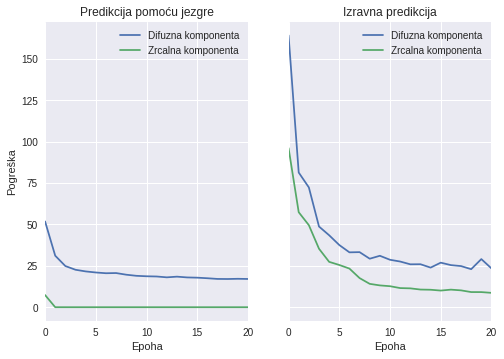

In [0]:
fig, (ax1, ax2) = plt.subplots(1, 2, sharey=True)

ax1.plot(klDiff, label='Difuzna komponenta')
ax1.plot(klSpec, label='Zrcalna komponenta')
ax1.set_title('Predikcija pomoću jezgre')
ax1.set_xlim([0, 20])
ax1.set_xlabel('Epoha')
ax1.set_ylabel('Pogreška')
ax1.legend()

ax2.plot(dlDiff, label='Difuzna komponenta')
ax2.plot(dlSpec, label='Zrcalna komponenta')
ax2.set_title('Izravna predikcija')
ax2.set_xlim([0, 20])
ax2.set_xlabel('Epoha')
ax2.legend()

plt.show()

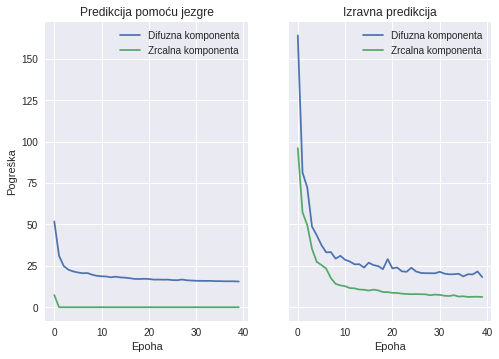

In [0]:
fig, (ax1, ax2) = plt.subplots(1, 2, sharey=True)

ax1.plot(klDiff, label='Difuzna komponenta')
ax1.plot(klSpec, label='Zrcalna komponenta')
ax1.set_title('Predikcija pomoću jezgre')
ax1.set_xlabel('Epoha')
ax1.set_ylabel('Pogreška')
ax1.legend()

ax2.plot(dlDiff, label='Difuzna komponenta')
ax2.plot(dlSpec, label='Zrcalna komponenta')
ax2.set_title('Izravna predikcija')
ax2.set_xlabel('Epoha')
ax2.legend()

plt.show()

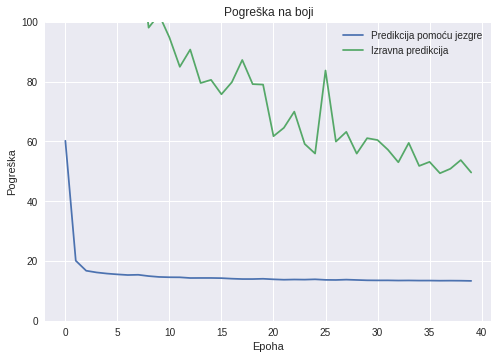

In [0]:
plt.plot(klFinal, label='Predikcija pomoću jezgre')
plt.plot(dlFinal, label='Izravna predikcija')
plt.title('Pogreška na boji')
plt.legend()
plt.xlabel('Epoha')
plt.ylabel('Pogreška')
plt.ylim([0, 100])

plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


X_diff shape: (720, 1280, 28)
float32 float32
Channel diffuse not found in data!
Channel specular not found in data!
Channel depth not found in data!


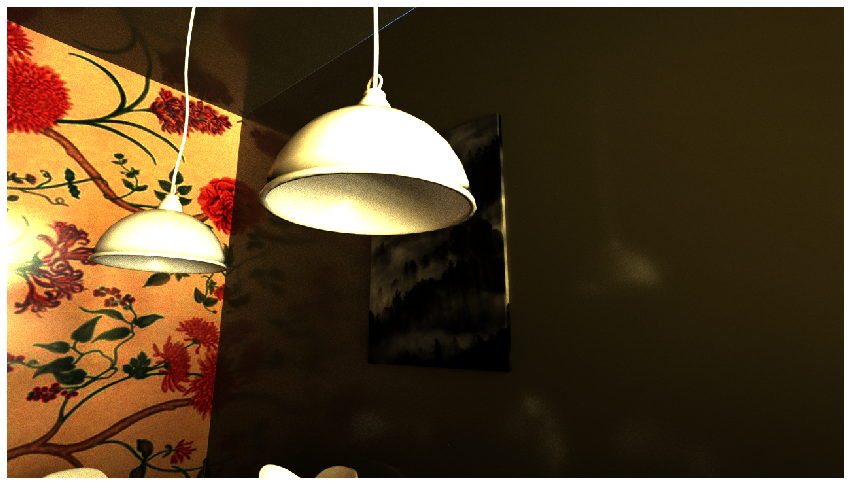

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


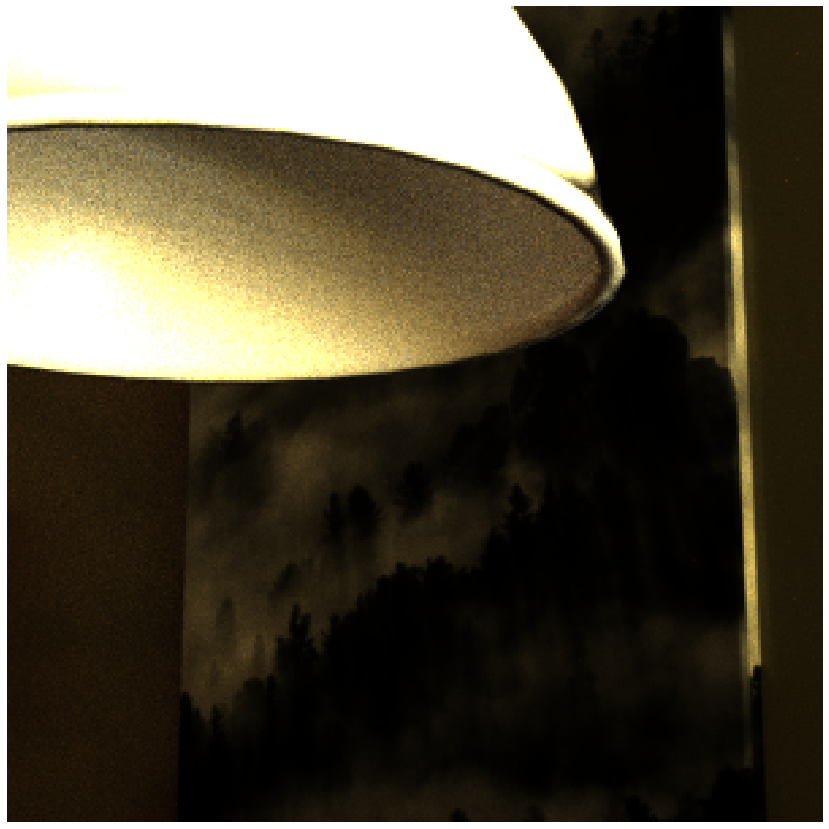

In [0]:
eval_data = preprocess_input("eval1.exr", "evalref1.exr")
show_data(eval_data['finalGt'])

eval_data = crop(eval_data, (1280//2, 720//2), 300)

show_data(eval_data['finalGt'])

In [0]:
def unsqueeze_all(d):
  for k, v in d.items():
    d[k] = torch.unsqueeze(v, dim=0)
  return d

def denoise(diffuseNet, specularNet, data, debug=False):
  with torch.no_grad():
    out_channels = diffuseNet[len(diffuseNet)-1].out_channels
    mode = 'DPCN' if out_channels == 3 else 'KPCN'
    criterion = nn.L1Loss()
    
    if debug:
      print("Out channels:", out_channels)
      print("Detected mode", mode)
    
    # make singleton batch
    data = send_to_device(to_torch_tensors(data))
    if len(data['X_diff'].size()) != 4:
      data = unsqueeze_all(data)
    
    print(data['X_diff'].size())
    
    X_diff = data['X_diff'].permute(permutation).to(device)
    Y_diff = data['Reference'][:,:,:,:3].permute(permutation).to(device)

    # forward + backward + optimize
    outputDiff = diffuseNet(X_diff)

    # print(outputDiff.shape)

    if mode == 'KPCN':
      X_input = crop_like(X_diff, outputDiff)
      outputDiff = apply_kernel(outputDiff, X_input)

    Y_diff = crop_like(Y_diff, outputDiff)

    lossDiff = criterion(outputDiff, Y_diff).item()

    # get the inputs
    X_spec = data['X_spec'].permute(permutation).to(device)
    Y_spec = data['Reference'][:,:,:,3:6].permute(permutation).to(device)

    # forward + backward + optimize
    outputSpec = specularNet(X_spec)

    if mode == 'KPCN':
      X_input = crop_like(X_spec, outputSpec)
      outputSpec = apply_kernel(outputSpec, X_input)

    Y_spec = crop_like(Y_spec, outputSpec)

    lossSpec = criterion(outputSpec, Y_spec).item()

    # calculate final ground truth error
    albedo = data['origAlbedo'].permute(permutation).to(device)
    albedo = crop_like(albedo, outputDiff)
    outputFinal = outputDiff * (albedo + eps) + torch.exp(outputSpec) - 1.0

    if True:
      print("Sample, denoised, gt")
      sz = 15
      orig = crop_like(data['finalInput'].permute(permutation), outputFinal)
      orig = orig.cpu().permute([0, 2, 3, 1]).numpy()[0,:]
      show_data(orig, figsize=(sz,sz), normalize=True)
      img = outputFinal.cpu().permute([0, 2, 3, 1]).numpy()[0,:]
      show_data(img, figsize=(sz,sz), normalize=True)
      gt = crop_like(data['finalGt'].permute(permutation), outputFinal)
      gt = gt.cpu().permute([0, 2, 3, 1]).numpy()[0,:]
      show_data(gt, figsize=(sz,sz), normalize=True)

    Y_final = data['finalGt'].permute(permutation).to(device)

    Y_final = crop_like(Y_final, outputFinal)
    
    lossFinal = criterion(outputFinal, Y_final).item()
    
    if debug:
      print("LossDiff:", lossDiff)
      print("LossSpec:", lossSpec)
      print("LossFinal:", lossFinal)
    
    
  

Detected mode KPCN
torch.Size([1, 301, 301, 28])
Sample, denoised, gt


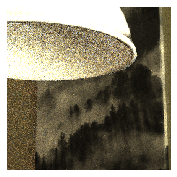

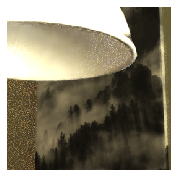

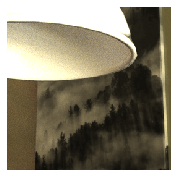

LossDiff: 0.04816475883126259
LossSpec: 2.8602256197177156e-13
LossFinal: 0.03435186296701431


In [0]:
denoise(kdiffuseNet, kspecularNet, eval_data, debug=True)

X_diff shape: (720, 1280, 28)
float32 float32
Channel diffuse not found in data!
Channel specular not found in data!
Channel depth not found in data!
Out channels: 3
Detected mode DPCN
torch.Size([1, 301, 301, 28])
Sample, denoised, gt


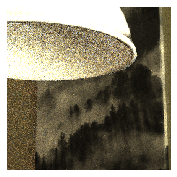

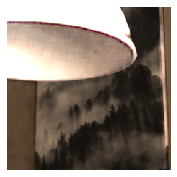

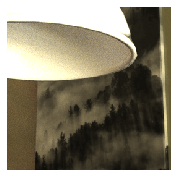

LossDiff: 0.08303730189800262
LossSpec: 0.009935930371284485
LossFinal: 0.04818328097462654


In [0]:
eval_data = preprocess_input("eval1.exr", "evalref1.exr")
eval_data = crop(eval_data, (1280//2, 720//2), 300)

denoise(ddiffuseNet, dspecularNet, eval_data, debug=True)

--2019-01-23 14:37:40--  https://www.dropbox.com/s/e9kyil0isfiu0ng/30265043-00256spp.exr?dl=1
Resolving www.dropbox.com (www.dropbox.com)... 162.125.82.1, 2620:100:6032:1::a27d:5201
Connecting to www.dropbox.com (www.dropbox.com)|162.125.82.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/dl/e9kyil0isfiu0ng/30265043-00256spp.exr [following]
--2019-01-23 14:37:41--  https://www.dropbox.com/s/dl/e9kyil0isfiu0ng/30265043-00256spp.exr
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucaca1311e3b2ca735c73a8fe9ac.dl.dropboxusercontent.com/cd/0/get/AZ_moapR-yiVy79XoBKjLHmnfLBzdN_VCXVIf_U3npKpM9uhlewnc5gEM8xIlY5gtA_3jaPHuVSRdob1hWkN_X_TSw8eSagyXW283F5-sHoat0jIugS42uSD92BVhioMm0CGlIk972UggbdbeTNyXNeqdfPP-sr_LhbSJArwXHAPJunXoiE0vM71HfFdvyCewQk/file?dl=1# [following]
--2019-01-23 14:37:41--  https://ucaca1311e3b2ca735c73a8fe9ac.dl.dropboxusercontent.com/cd/0/get/AZ_moapR-yiVy79XoB

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


X_diff shape: (720, 1280, 28)
float32 float32
Channel diffuse not found in data!
Channel specular not found in data!
Channel depth not found in data!


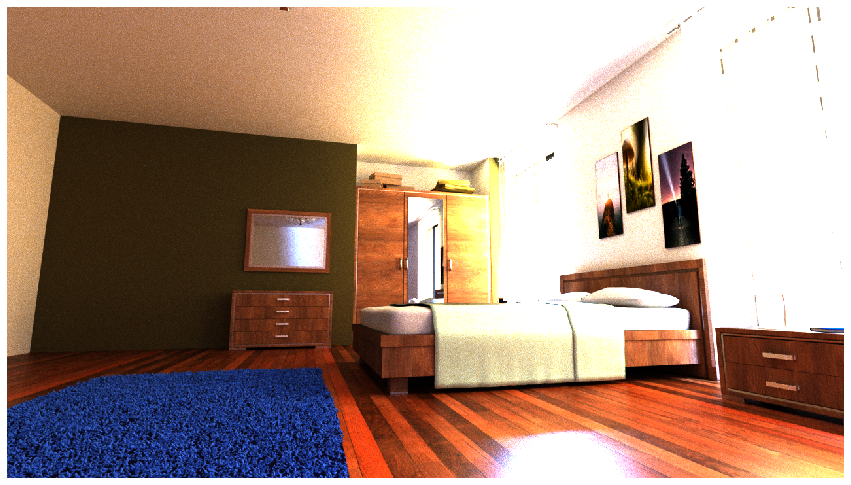

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


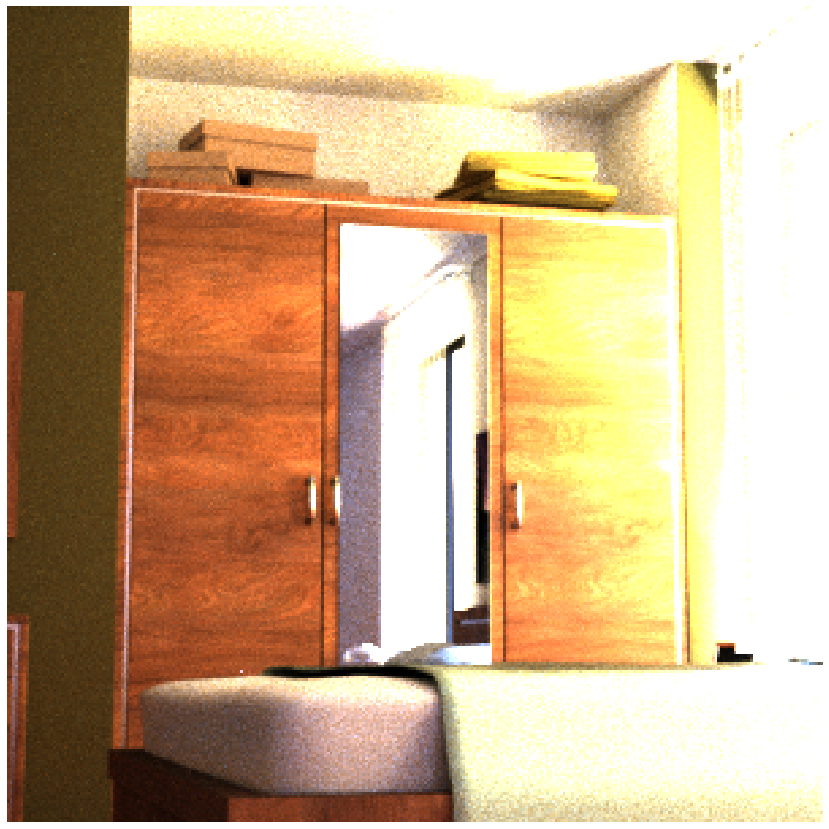

In [0]:

!wget -O eval2.exr https://www.dropbox.com/s/e9kyil0isfiu0ng/30265043-00256spp.exr?dl=1
  
!wget -O evalref2.exr https://www.dropbox.com/s/uuudw2av8vgzsjw/30265043-08192spp.exr?dl=1

eval_data = preprocess_input("eval2.exr", "evalref2.exr")
show_data(eval_data['finalGt'])

eval_data = crop(eval_data, (1280//2, 720//2), 300)

show_data(eval_data['finalGt'])

Out channels: 441
Detected mode KPCN
torch.Size([1, 301, 301, 28])
Sample, denoised, gt


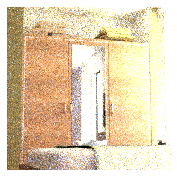

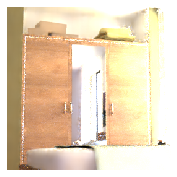

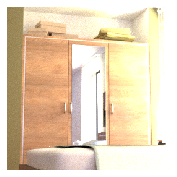

LossDiff: 0.2504343092441559
LossSpec: 4.3342894377740304e-12
LossFinal: 0.11661256104707718


In [0]:
denoise(kdiffuseNet, kspecularNet, eval_data, debug=True)

Out channels: 3
Detected mode DPCN
torch.Size([1, 301, 301, 28])
Sample, denoised, gt


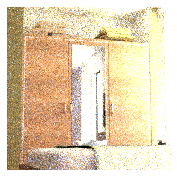

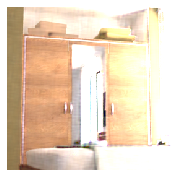

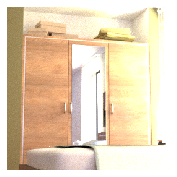

LossDiff: 0.3867200016975403
LossSpec: 0.022754985839128494
LossFinal: 0.19188985228538513


In [0]:
denoise(ddiffuseNet, dspecularNet, eval_data, debug=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


X_diff shape: (720, 1280, 28)
float32 float32
Channel diffuse not found in data!
Channel specular not found in data!
Channel depth not found in data!


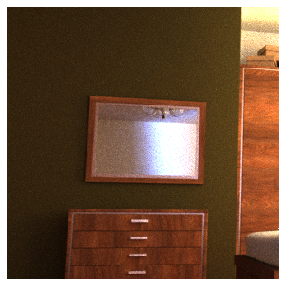

In [0]:
eval_data = preprocess_input("eval2.exr", "evalref2.exr")

eval_data = crop(eval_data, (1280//3, 720//2), 300)

show_data(eval_data['finalGt'], figsize=(5, 5))

Out channels: 441
Detected mode KPCN
torch.Size([1, 301, 301, 28])
Sample, denoised, gt


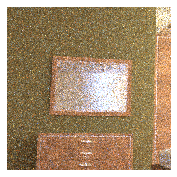

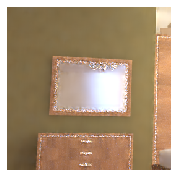

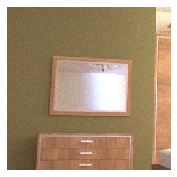

LossDiff: 0.079686239361763
LossSpec: 5.453763742696571e-12
LossFinal: 0.029021771624684334
Out channels: 3
Detected mode DPCN
torch.Size([1, 301, 301, 28])
Sample, denoised, gt


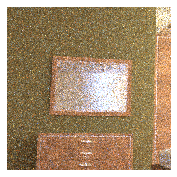

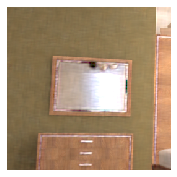

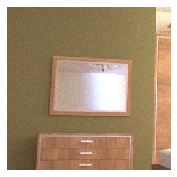

LossDiff: 0.09705003350973129
LossSpec: 0.01077180728316307
LossFinal: 0.03052554279565811


In [0]:
denoise(kdiffuseNet, kspecularNet, eval_data, debug=True)
denoise(ddiffuseNet, dspecularNet, eval_data, debug=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


X_diff shape: (720, 1280, 28)
float32 float32
Channel diffuse not found in data!
Channel specular not found in data!
Channel depth not found in data!


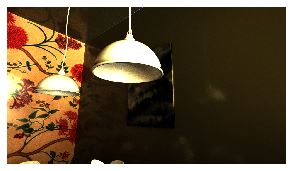

In [0]:
eval_data = preprocess_input("eval1.exr", "evalref1.exr")

#eval_data = crop(eval_data, (1280//3, 720//2), 300)

show_data(eval_data['finalGt'], figsize=(5, 5))

Out channels: 441
Detected mode KPCN
torch.Size([1, 720, 1280, 28])
Sample, denoised, gt


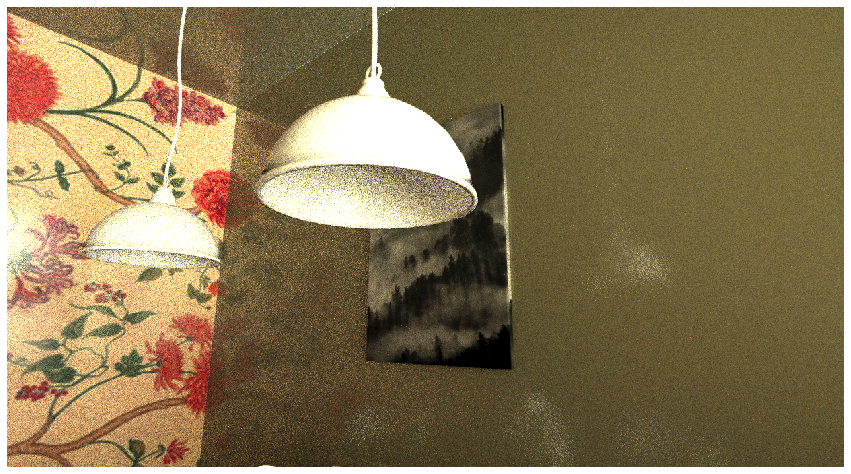

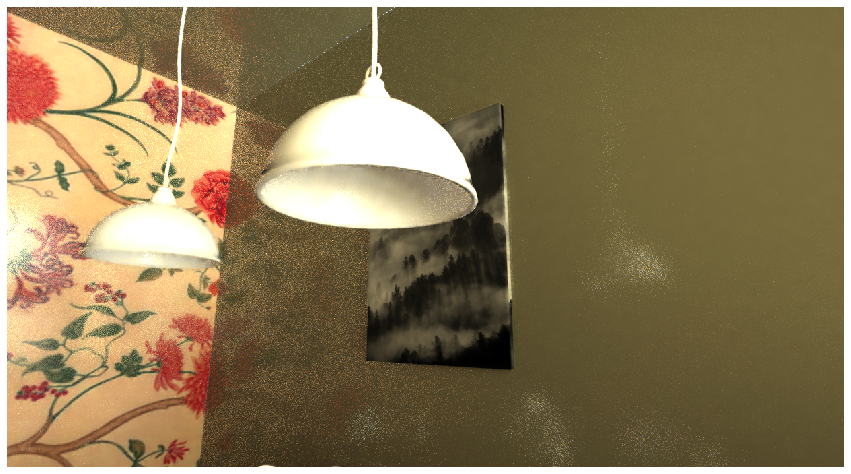

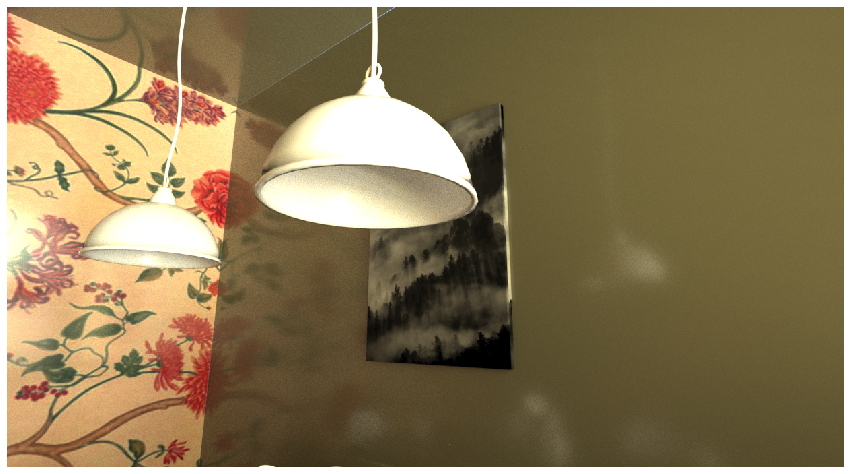

LossDiff: 0.026683319360017776
LossSpec: 2.6497043898203107e-14
LossFinal: 0.026355614885687828
Out channels: 3
Detected mode DPCN
torch.Size([1, 720, 1280, 28])
Sample, denoised, gt


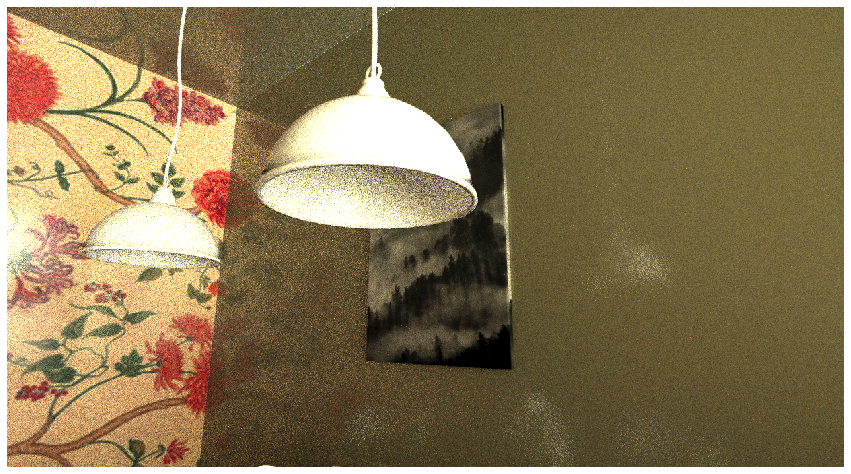

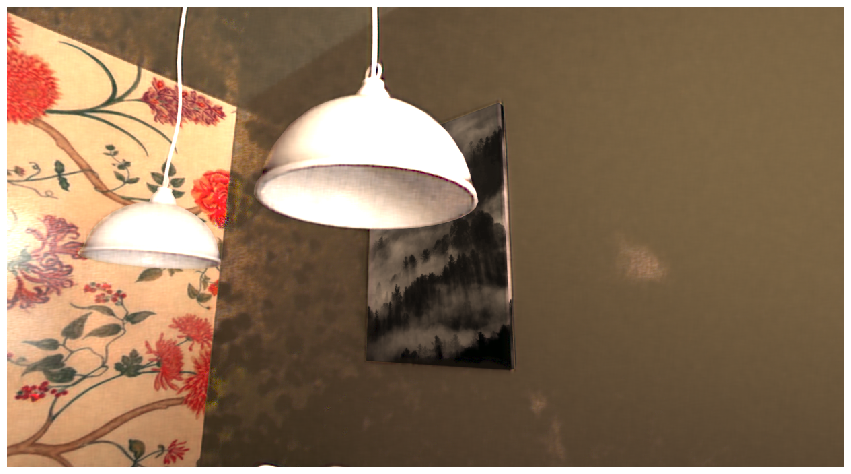

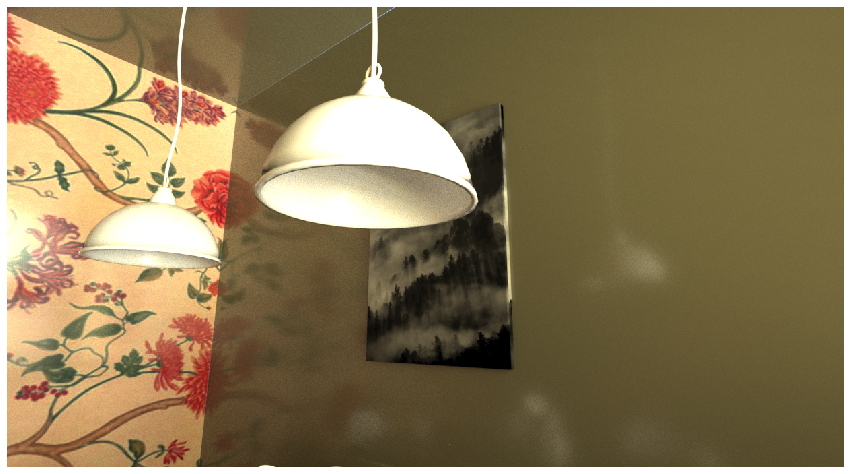

LossDiff: 0.057362522929906845
LossSpec: 0.014528940431773663
LossFinal: 0.03186148777604103


In [0]:
denoise(kdiffuseNet, kspecularNet, eval_data, debug=True)
denoise(ddiffuseNet, dspecularNet, eval_data, debug=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


X_diff shape: (720, 1280, 28)
float32 float32
Channel diffuse not found in data!
Channel specular not found in data!
Channel depth not found in data!


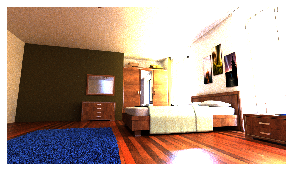

In [0]:
eval_data = preprocess_input("eval2.exr", "evalref2.exr")

show_data(eval_data['finalGt'], figsize=(5, 5))

Out channels: 441
Detected mode KPCN
torch.Size([1, 720, 1280, 28])
Sample, denoised, gt


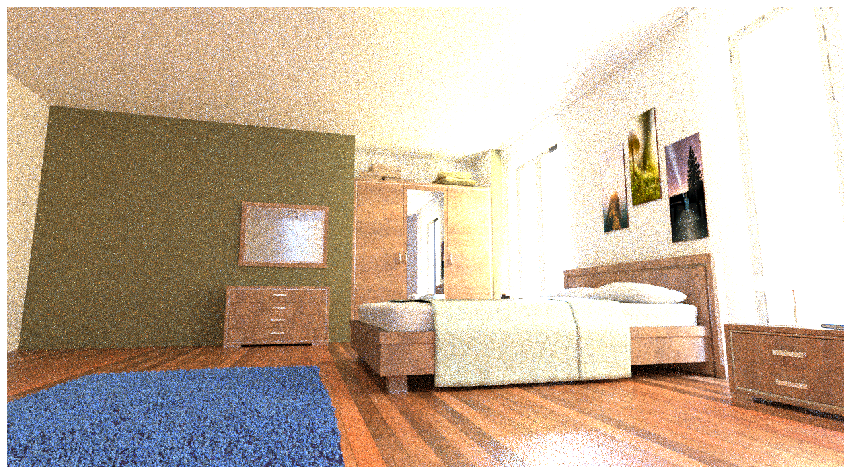

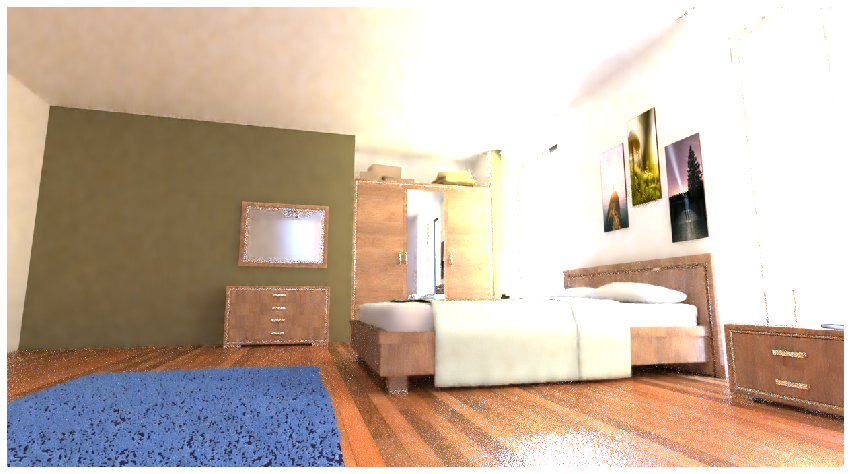

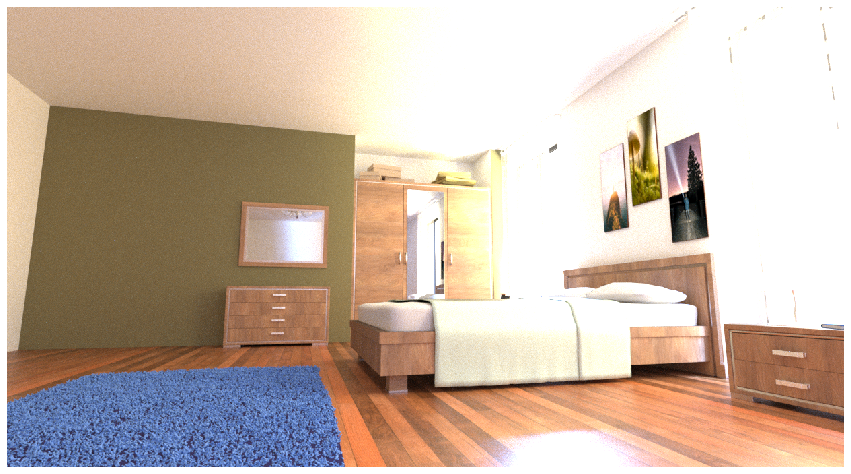

LossDiff: 0.1375030279159546
LossSpec: 1.1623499471952181e-12
LossFinal: 0.12699368596076965
Out channels: 3
Detected mode DPCN
torch.Size([1, 720, 1280, 28])
Sample, denoised, gt


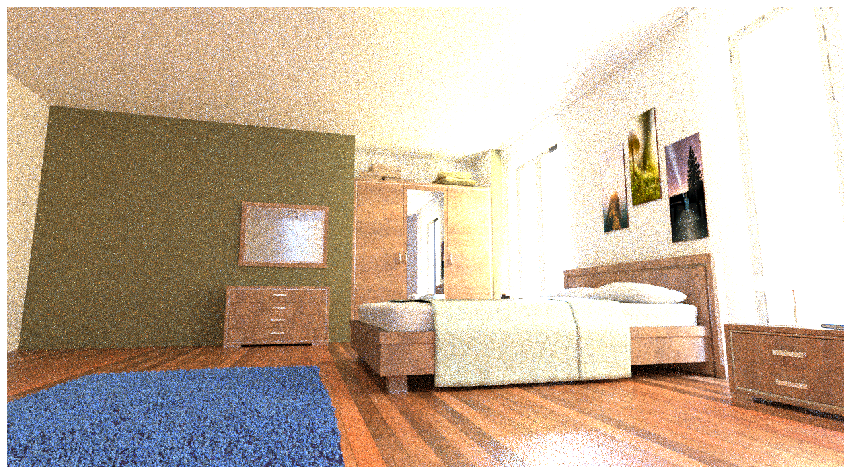

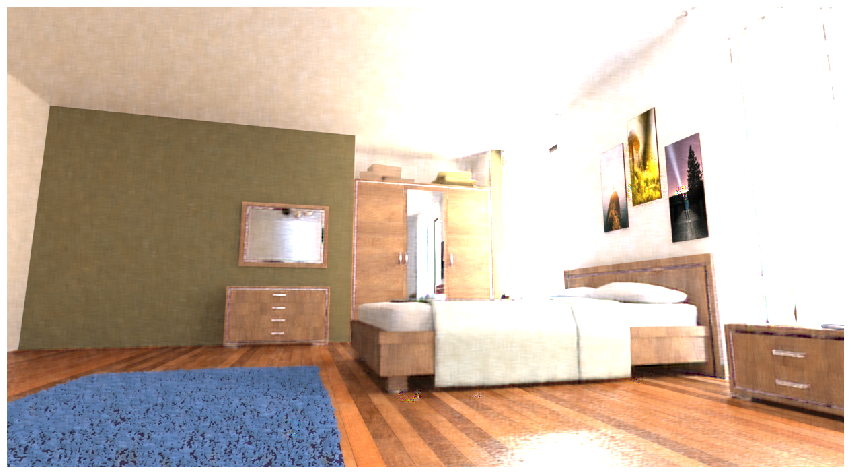

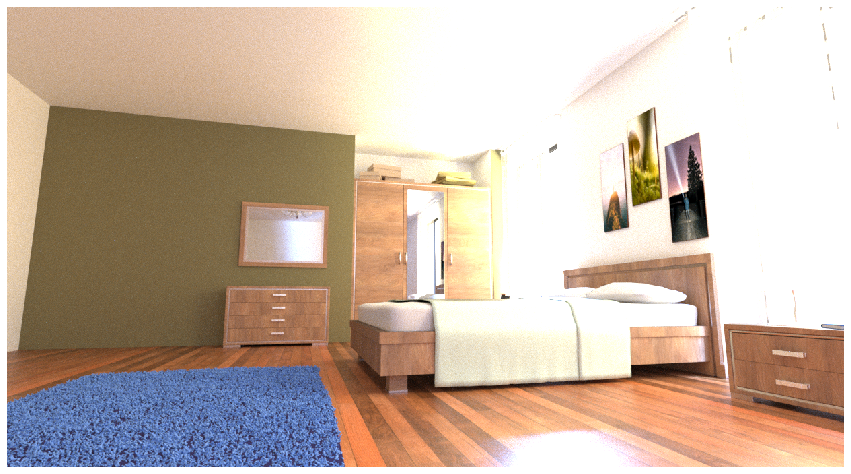

LossDiff: 0.19468453526496887
LossSpec: 0.026960309594869614
LossFinal: 0.40801817178726196


In [0]:
denoise(kdiffuseNet, kspecularNet, eval_data, debug=True)
denoise(ddiffuseNet, dspecularNet, eval_data, debug=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


X_diff shape: (720, 1280, 28)
float32 float32
Channel diffuse not found in data!
Channel specular not found in data!
Channel depth not found in data!


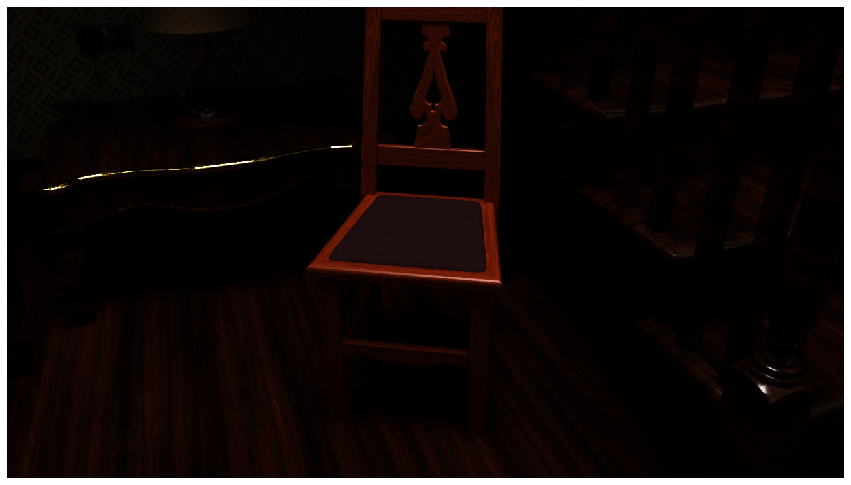

In [0]:

  
  
eval_data = preprocess_input("eval3.exr", "evalref3.exr")
show_data(eval_data['finalGt'])


Out channels: 441
Detected mode KPCN
torch.Size([1, 720, 1280, 28])
Sample, denoised, gt


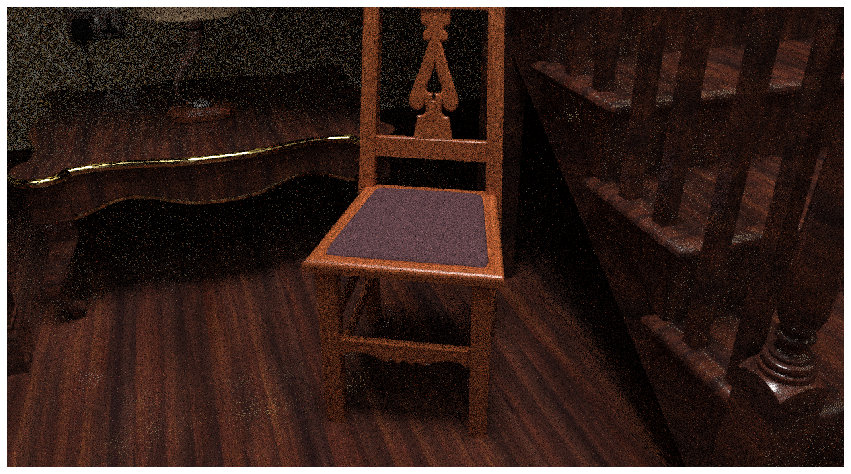

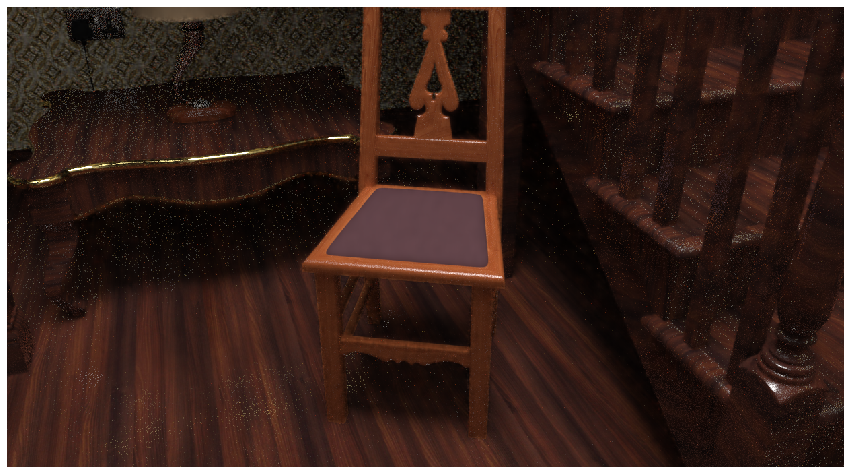

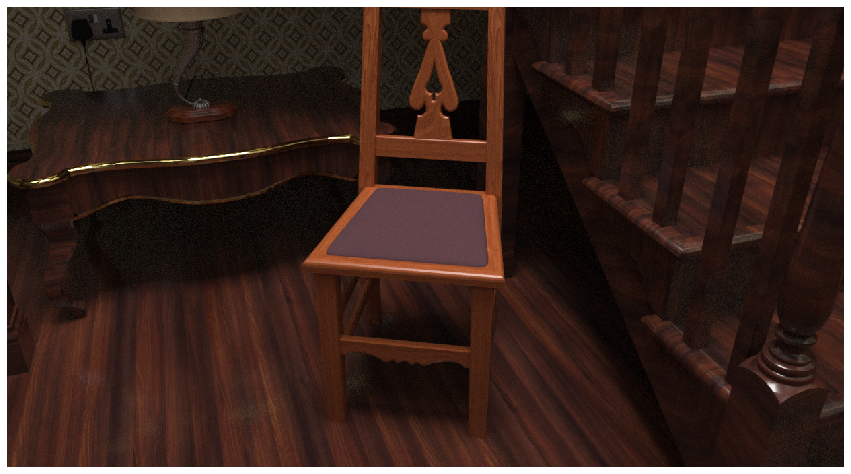

LossDiff: 0.01627540960907936
LossSpec: 2.5342254161841993e-07
LossFinal: 0.004549012053757906
Out channels: 3
Detected mode DPCN
torch.Size([1, 720, 1280, 28])
Sample, denoised, gt


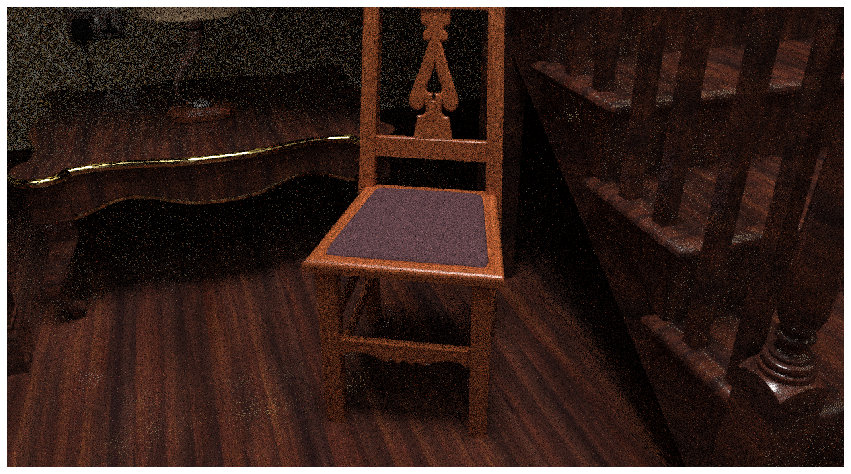

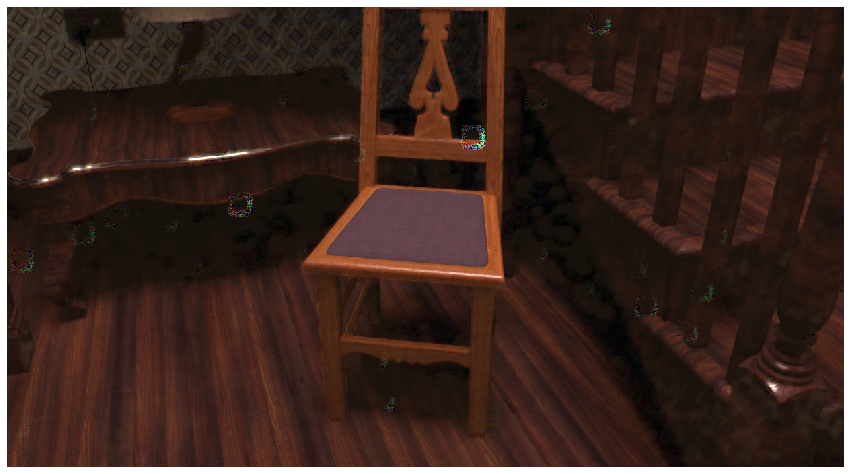

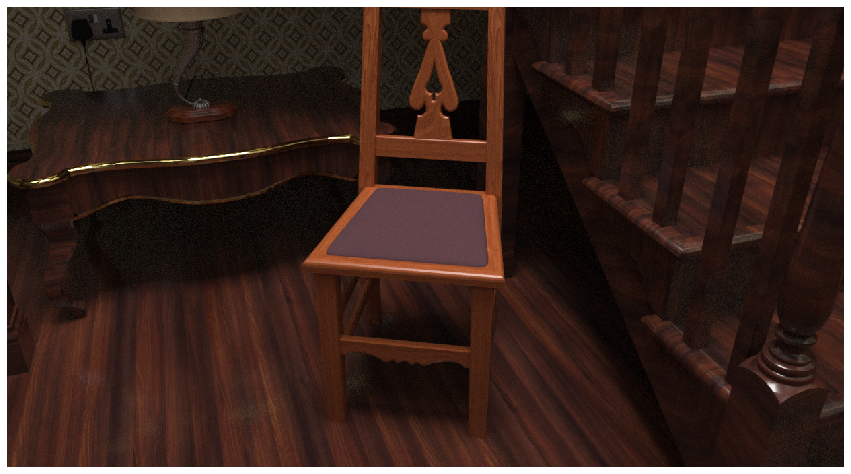

LossDiff: 0.018974486738443375
LossSpec: 0.004146127495914698
LossFinal: 0.006152958609163761


In [0]:
denoise(kdiffuseNet, kspecularNet, eval_data, debug=True)
denoise(ddiffuseNet, dspecularNet, eval_data, debug=True)

In [0]:
!wget -O eval4.exr https://www.dropbox.com/s/jib5tda6bey30ce/25922544-00256spp.exr?dl=1
  
!wget -O evalref4.exr https://www.dropbox.com/s/ud0i5pf4f4zbbjj/25922544-08192spp.exr?dl=1

--2019-01-23 15:05:42--  https://www.dropbox.com/s/jib5tda6bey30ce/25922544-00256spp.exr?dl=1
Resolving www.dropbox.com (www.dropbox.com)... 162.125.82.1, 2620:100:6032:1::a27d:5201
Connecting to www.dropbox.com (www.dropbox.com)|162.125.82.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/dl/jib5tda6bey30ce/25922544-00256spp.exr [following]
--2019-01-23 15:05:42--  https://www.dropbox.com/s/dl/jib5tda6bey30ce/25922544-00256spp.exr
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc3bfe6cd73282b699ccd482a1b7.dl.dropboxusercontent.com/cd/0/get/AZ8Tyn64AjB2Z4huhwPluL9XcmVz-Ea83cidS8ckzlB4NtMurYAPjU18gbfSVxWQZeMhnWNjIExmSXcfu0bBDzcfDYqPP1fYb6qtLA5W1gEbuMWVkviGWQGc8kLd6MGb9fv3SCnduEnXkkIxP1pap5PM5gHa0cOAmkK35UBgSw-qCB8bsjnyoFBq9RVFnpgEaqw/file?dl=1# [following]
--2019-01-23 15:05:43--  https://uc3bfe6cd73282b699ccd482a1b7.dl.dropboxusercontent.com/cd/0/get/AZ8Tyn64AjB2Z4huhw

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


X_diff shape: (720, 1280, 28)
float32 float32
Channel diffuse not found in data!
Channel specular not found in data!
Channel depth not found in data!


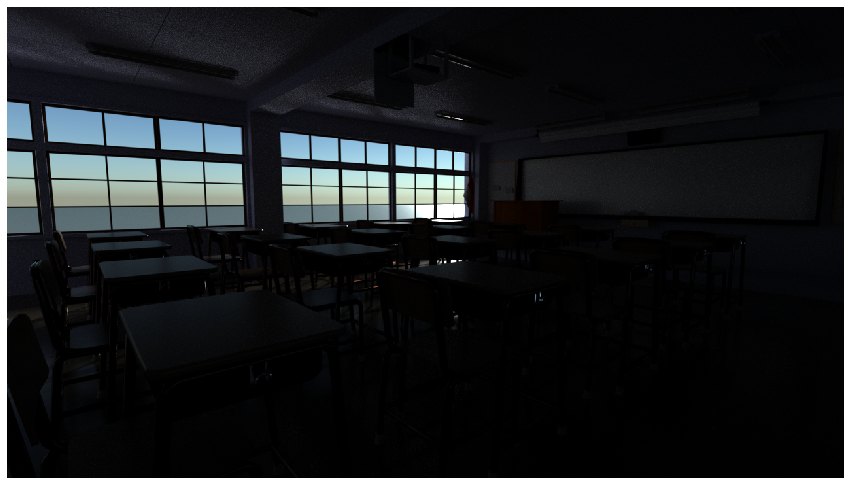

In [0]:
eval_data = preprocess_input("eval4.exr", "evalref4.exr")
show_data(eval_data['finalGt'])

Out channels: 441
Detected mode KPCN
torch.Size([1, 720, 1280, 28])
Sample, denoised, gt


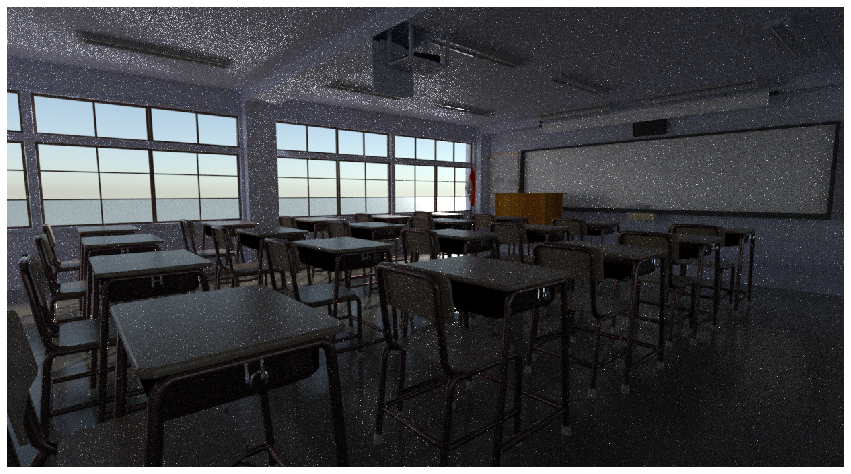

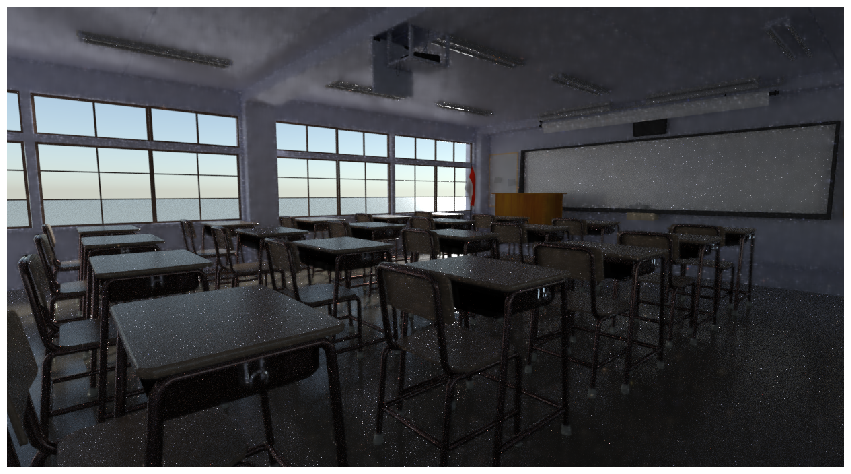

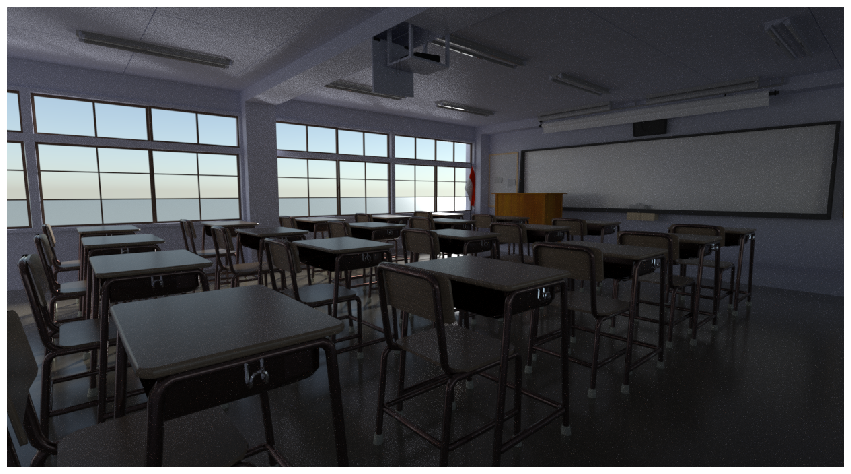

LossDiff: 0.0068111177533864975
LossSpec: 1.0069152976688311e-11
LossFinal: 0.006507162004709244
Out channels: 3
Detected mode DPCN
torch.Size([1, 720, 1280, 28])
Sample, denoised, gt


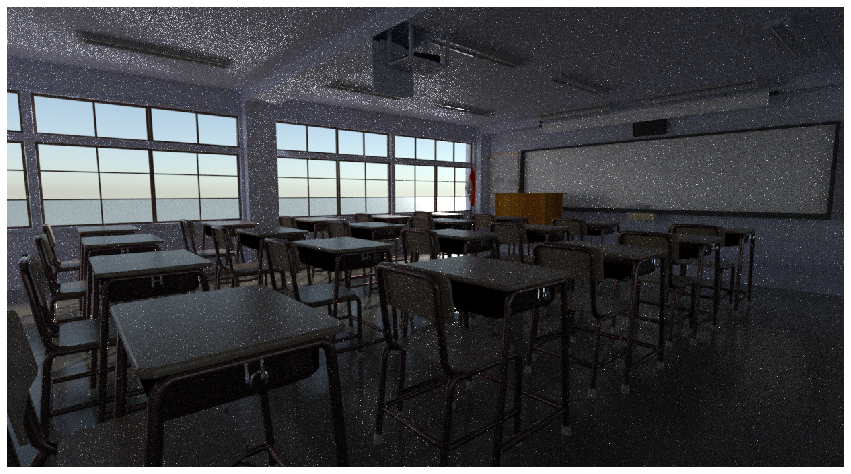

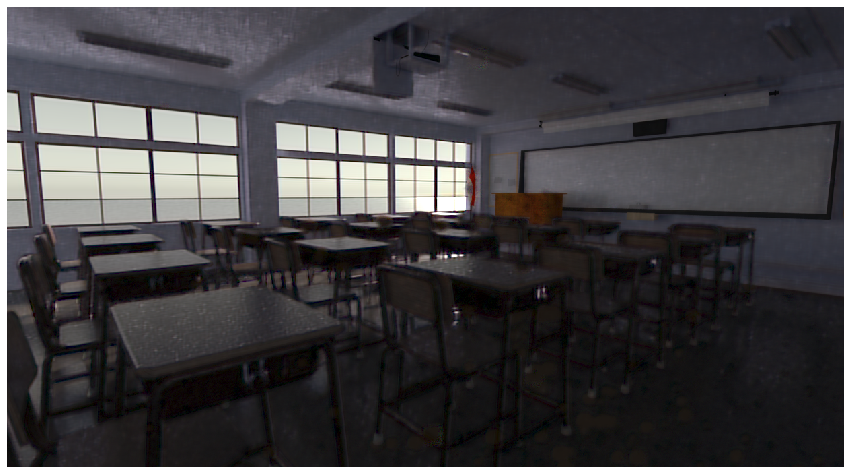

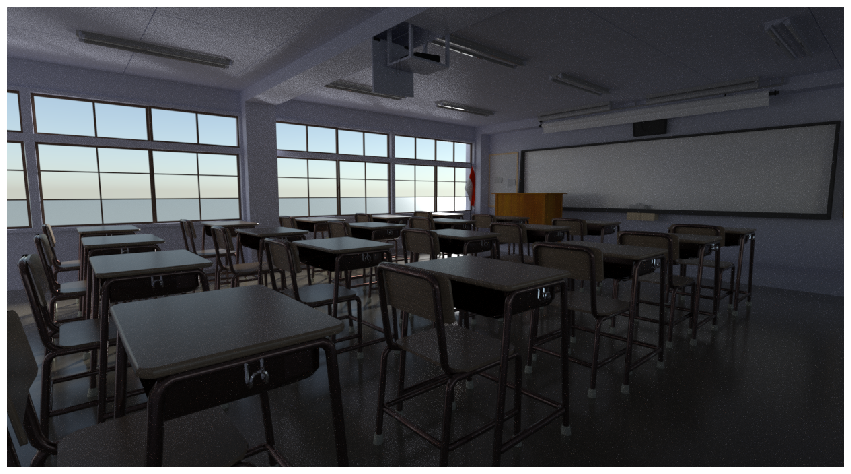

LossDiff: 0.007807157002389431
LossSpec: 0.00799619685858488
LossFinal: 0.01374348159879446


In [0]:
denoise(kdiffuseNet, kspecularNet, eval_data, debug=True)
denoise(ddiffuseNet, dspecularNet, eval_data, debug=True)

In [0]:
net = make_net(9, 'KPCN')

def count_parameters(model):
    total_param = 0
    for name, param in model.named_parameters():
        if param.requires_grad:
            num_param = np.prod(param.size())
            if param.dim() > 1:
                print(name, ':', 'x'.join(str(x) for x in list(param.size())), '=', num_param)
            else:
                print(name, ':', num_param)
            total_param += num_param
    return total_param
  
print(count_parameters(net))

net = make_net(9, 'DPCN')


print(count_parameters(net))

250100
250100
250100
250100
250100
250100
250100
0.weight : 100x28x5x5 = 70000
0.bias : 100
2.weight : 100x100x5x5 = 250000
2.bias : 100
4.weight : 100x100x5x5 = 250000
4.bias : 100
6.weight : 100x100x5x5 = 250000
6.bias : 100
8.weight : 100x100x5x5 = 250000
8.bias : 100
10.weight : 100x100x5x5 = 250000
10.bias : 100
12.weight : 100x100x5x5 = 250000
12.bias : 100
14.weight : 100x100x5x5 = 250000
14.bias : 100
16.weight : 441x100x5x5 = 1102500
16.bias : 441
2923741
250100
250100
250100
250100
250100
250100
250100
0.weight : 100x28x5x5 = 70000
0.bias : 100
2.weight : 100x100x5x5 = 250000
2.bias : 100
4.weight : 100x100x5x5 = 250000
4.bias : 100
6.weight : 100x100x5x5 = 250000
6.bias : 100
8.weight : 100x100x5x5 = 250000
8.bias : 100
10.weight : 100x100x5x5 = 250000
10.bias : 100
12.weight : 100x100x5x5 = 250000
12.bias : 100
14.weight : 100x100x5x5 = 250000
14.bias : 100
16.weight : 3x100x5x5 = 7500
16.bias : 3
1828303
